# Grado en Robótica - Visión Artificial
## Práctica 4: Modelos de salencia espectrais e a súa avaliación
### Autor: Adrián Losada Álvarez

# Tarea 1: Saliencia estática

### Importamos las librerías necesarias

In [7]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

import cv2
import numpy as np
import matplotlib
matplotlib.use('TkAgg')
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.io as sio
import pandas as pd
import os
import pySaliencyMap

## **Implementación de algoritmos**

### Creamos un algoritmo que obtenga el mapa de saliencia mediante el método del **residuo espectral (SR)** incluyendo información de color. Además de una posible forma de obtener saliencia invariante a la escala.

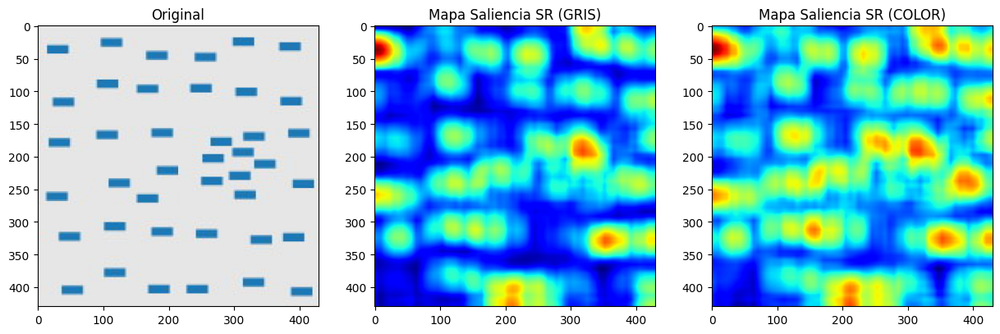

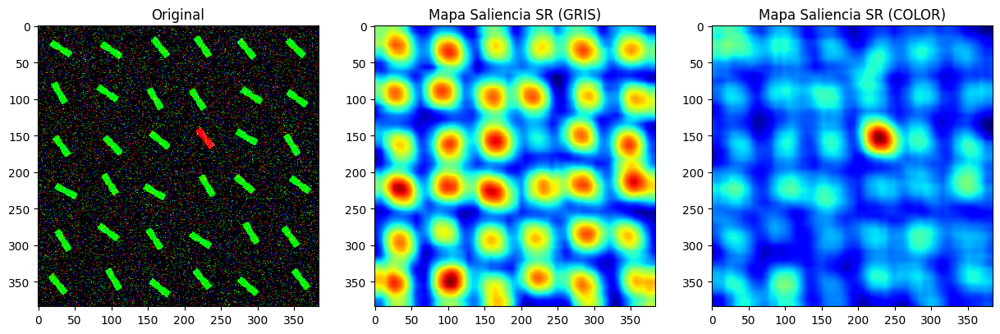

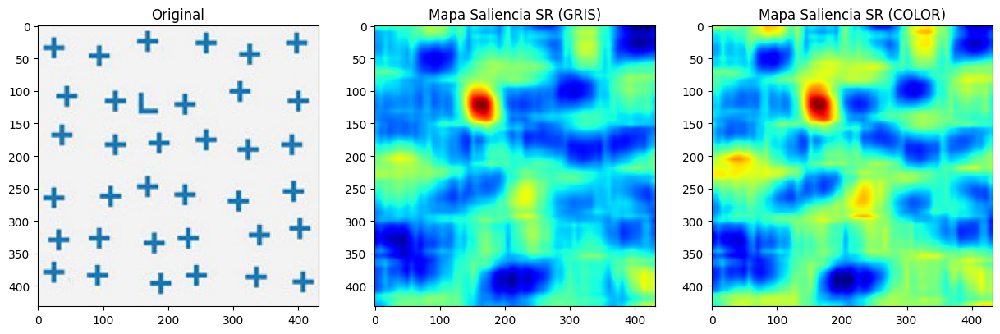

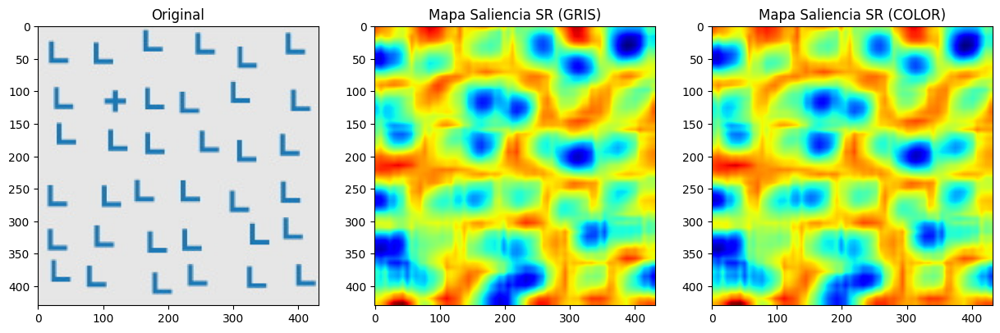

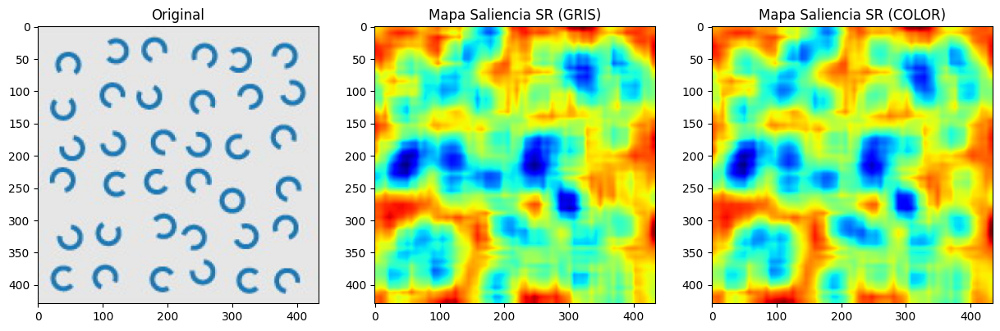

In [9]:
WIDTH = 64

# Función para calcular el mapa de saliencia basado en el residuo espectral considerando información de color e invariante a la escala
def SR_Color_Multiescala(img, num_scales=1):
    rows, cols = img.shape[0], img.shape[1]
    img = cv2.resize(img, (WIDTH,int(WIDTH*img.shape[0]/img.shape[1])))

    # Crear la pirámide gaussiana
    pyramid = [img]
    for _ in range(num_scales-1):
        img = cv2.pyrDown(img)
        pyramid.append(img)

    # Lista en la que se almacenarán los mapas de saliencia a distintas escalas
    smSS = []

    for scaled_img in pyramid:
        # Si es una imagen en escala de grises (no se puede obtener información de color) 
        if len(scaled_img.shape) == 2:
            # Transformada de Fourier
            c = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
            mag = np.sqrt(c[:, :, 0] ** 2 + c[:, :, 1] ** 2)
            spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))

            # Aplicación del residuo espectral en el dominio de la frecuencia
            c[:, :, 0] = c[:, :, 0] * spectralResidual / mag
            c[:, :, 1] = c[:, :, 1] * spectralResidual / mag
            c = cv2.dft(c, flags=(cv2.DFT_INVERSE | cv2.DFT_SCALE))
            mag = c[:, :, 0] ** 2 + c[:, :, 1] ** 2

            # Suavizado y redimensionado
            sm = cv2.resize(cv2.GaussianBlur(mag,(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

        # Si es una imagen a color
        else:
            # Obtener los canales B, G, R
            B = scaled_img[:, :, 0]
            G = scaled_img[:, :, 1]
            R = scaled_img[:, :, 2]
            channels = [B, G, R]
            results = []

            # Para cada canal
            for i in range(len(channels)):
                # Transformada de Fourier para el canal actual
                c = cv2.dft(np.float32(channels[i]), flags=cv2.DFT_COMPLEX_OUTPUT)
                mag = np.sqrt(c[:, :, 0] ** 2 + c[:, :, 1] ** 2)
                spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))

                # Aplicación del residuo espectral al canal en el dominio de la frecuencia
                c[:, :, 0] = c[:, :, 0] * spectralResidual / mag
                c[:, :, 1] = c[:, :, 1] * spectralResidual / mag
                c = cv2.dft(c, flags=(cv2.DFT_INVERSE | cv2.DFT_SCALE))
                mag = c[:, :, 0] ** 2 + c[:, :, 1] ** 2

                # Suavizado y redimensionado
                sm_channel = cv2.resize(cv2.GaussianBlur(mag,(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

                # Agregamos el mapa de saliencia del canal actual a la lista
                results.append(sm_channel)

            # Sumamos los mapas de saliencia de cada canal de color
            sm = np.sum(results, axis=0)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

    # Reconstruir la imagen con las pirámides
    sm_ = smSS[0]
    for i in range(1, len(smSS)+1):
        smSS[-i] = cv2.resize(smSS[-i], (cols, rows), cv2.NORM_MINMAX)
        sm_ = np.add(sm_, smSS[-i])

    # Normalización
    sm_norm = cv2.normalize(sm_, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return sm_norm


# Cargar imagen
dataPath = './imaxes_pop-out_proba/'
imagesList = os.listdir(dataPath)

for imgName in imagesList:
    # Cargamos las imágenes en escala de grises y con color
    imageGRAY = cv2.imread(dataPath+imgName, 0)
    imageCOLOR = cv2.imread(dataPath+imgName, 1)

    # Llamamos a la función para calcular los mapas de saliencia sin y con información de color
    smGRAY = SR_Color_Multiescala(imageGRAY, num_scales=1)
    smCOLOR = SR_Color_Multiescala(imageCOLOR, num_scales=1)

    # Visualización
    plt.figure(figsize=[15, 5])
    plt.subplot(1, 3, 1), plt.imshow(cv2.cvtColor(imageCOLOR, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(1, 3, 2), plt.imshow(smGRAY, cmap='jet'), plt.title('Mapa Saliencia SR (GRIS)')
    plt.subplot(1, 3, 3), plt.imshow(smCOLOR, cmap='jet'), plt.title('Mapa Saliencia SR (COLOR)')
    plt.show()

#### Análisis SR+COLOR
Observando los resultados anteriores podemos asegurar que incluir la información de color ayuda a obtener mejores mapa de saliencia en imágenes donde el color cobre un factor importante, ya que no siempre es así, por ejemplo en la segunda imagen se ve un cambio muy significativo ya que sin la información de color no se distinguirían las distintas figuras, obteniendo así un mapa de saliencia erróneo. Mientras que en el resto de ejemplos en donde todas las figuras son del mismo color y la única anomalía que presentan es la formas de estas, los mapas de saliencia con información de color no aportan nada.

### Implementamos un algoritmo que obtenga el mapa de saliencia mediante el método de la **fase global (PFT)** incluyendo información de color. Además de una posible forma de obtener saliencia invariante a la escala.

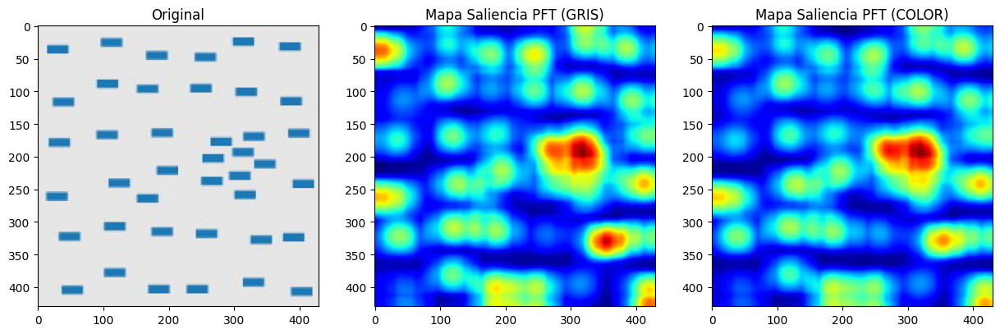

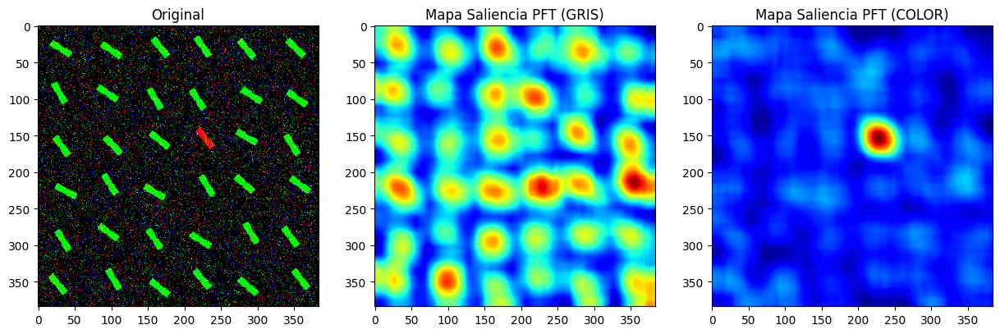

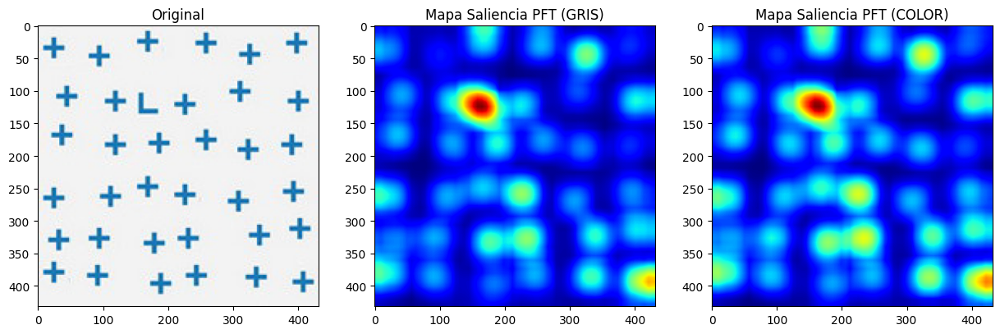

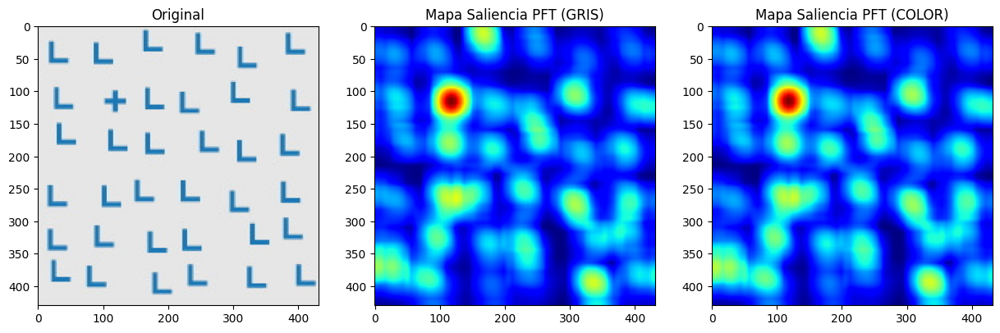

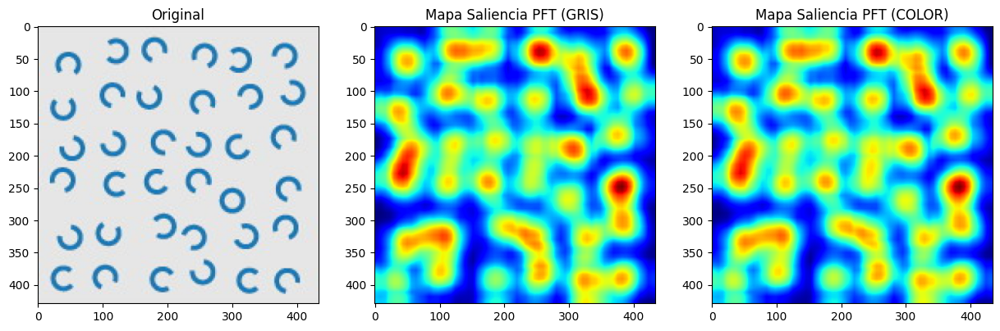

In [ ]:
WIDTH = 64

# Función para calcular el mapa de saliencia basado en el espectro de fase de la transformada de Fourier
def PFT_Color_Multiescala(img, num_scales=1):
    rows, cols = img.shape[0], img.shape[1]
    img = cv2.resize(img, (WIDTH,int(WIDTH*img.shape[0]/img.shape[1])))

    # Crear la pirámide gaussiana
    pyramid = [img]
    for _ in range(num_scales-1):
        img = cv2.pyrDown(img)
        pyramid.append(img)

    # Lista en la que se almacenarán los mapas de saliencia a distintas escalas
    smSS = []

    for scaled_img in pyramid:
        # Si es una imagen en escala de grises, no podemos obtener información de los colores 
        if len(img.shape) == 2:
            # Transformada de Fourier
            img_fft = np.fft.fft2(img)

            # Espectro de la fase de la imagen
            phase_espectrum = np.angle(img_fft)

            # Suavizado y redimensionado del mapa de saliencia
            sm = cv2.resize(cv2.GaussianBlur((np.abs(np.fft.ifft2(np.exp(1j * phase_espectrum)))**2),(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

        # Si es una imagen a color
        else:
            # Obtener los canales B, G, R
            B = scaled_img[:, :, 0]
            G = scaled_img[:, :, 1]
            R = scaled_img[:, :, 2]
            channels = [B, G, R]
            results = []

            # Para cada canal
            for i in range(len(channels)):
                # Transformada de Fourier
                img_fft = np.fft.fft2(channels[i])

                # Espectro de la fase de la imagen
                phase_espectrum = np.angle(img_fft)

                # Suavizado y redimensionado del mapa de saliencia para el canal actual
                sm_channel = cv2.resize(cv2.GaussianBlur((np.abs(np.fft.ifft2(np.exp(1j * phase_espectrum)))**2),(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

                # Agregamos el mapa de saliencia del canal actual a la lista
                results.append(sm_channel)

            # Sumamos los mapas de saliencia de cada canal de color
            sm = np.sum(results, axis=0)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

    # Reconstruir la imagen con las pirámides
    sm_ = smSS[0]
    for i in range(1, len(smSS)+1):
        smSS[-i] = cv2.resize(smSS[-i], (cols, rows), cv2.NORM_MINMAX)
        sm_ = np.add(sm_, smSS[-i])

    # Normalización
    sm_norm = cv2.normalize(sm_, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return sm_norm

# Cargar imagen
dataPath = '../imaxes_pop-out_proba/'
imagesList = os.listdir(dataPath)

for imgName in imagesList:
    # Cargamos las imágenes en escala de grises y con color
    imageGRAY = cv2.imread(dataPath+imgName, 0)
    imageCOLOR = cv2.imread(dataPath+imgName, 1)

    # Llamamos a la función para calcular los mapas de saliencia sin y con información de color
    smGRAY = PFT_Color_Multiescala(imageGRAY, num_scales=1)
    smCOLOR = PFT_Color_Multiescala(imageCOLOR, num_scales=1)

    # Visualización
    plt.figure(figsize=[15, 5])
    plt.subplot(1, 3, 1), plt.imshow(cv2.cvtColor(imageCOLOR, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(1, 3, 2), plt.imshow(smGRAY, cmap='jet'), plt.title('Mapa Saliencia PFT (GRIS)')
    plt.subplot(1, 3, 3), plt.imshow(smCOLOR, cmap='jet'), plt.title('Mapa Saliencia PFT (COLOR)')
    plt.show()

#### Análisis PFT+COLOR
El análisis de este algoritmo es similar al anterior, en las imágenes donde el color tiene un peso importante nuestro algoritmo con información de color es útil, mientras que en otras donde los colores son irrelevantes a la hora de detectar anomalías, nuestro algoritmo no aporta nada.

Por otro lado, en comparación del algoritmo anterior, el algoritmo de la fase global presenta mejores resultados al generar los mapas de saliencia, ya que es capaz de generar algunos mapas de saliencia que el modelo del residuo espectral no.

### Implementamos un algoritmo que obtenga el mapa de saliencia mediante el **modelo de Itti**.

[ WARN:0@5.349] global loadsave.cpp:248 findDecoder imread_('test1.png'): can't open/read file: check file path/integrity


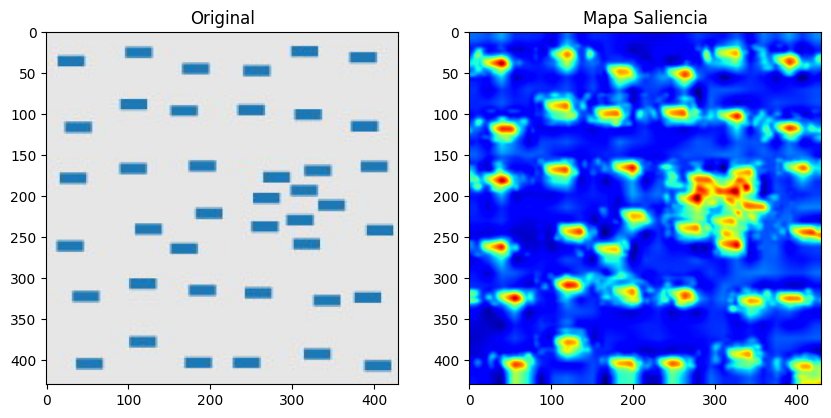

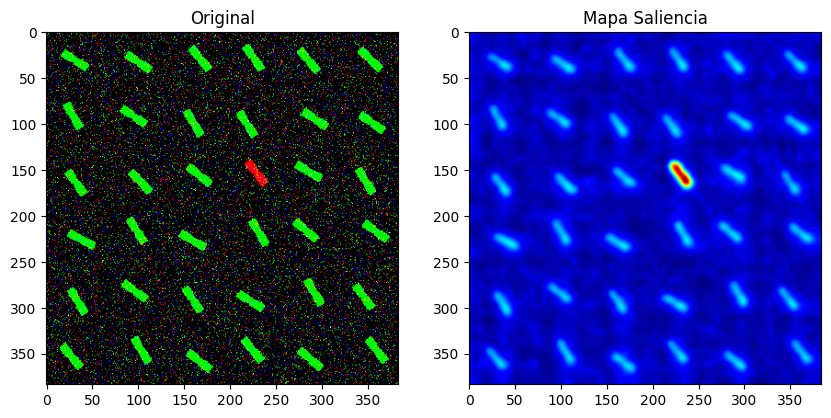

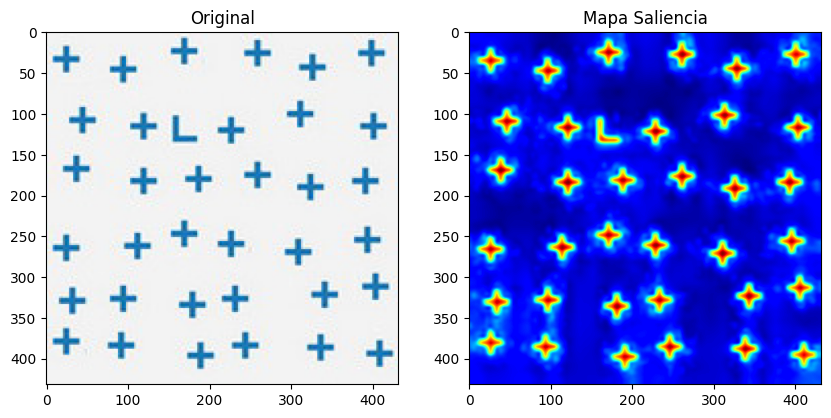

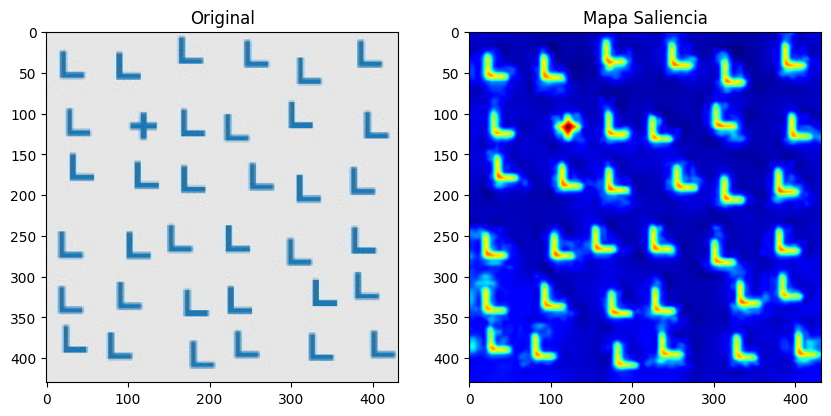

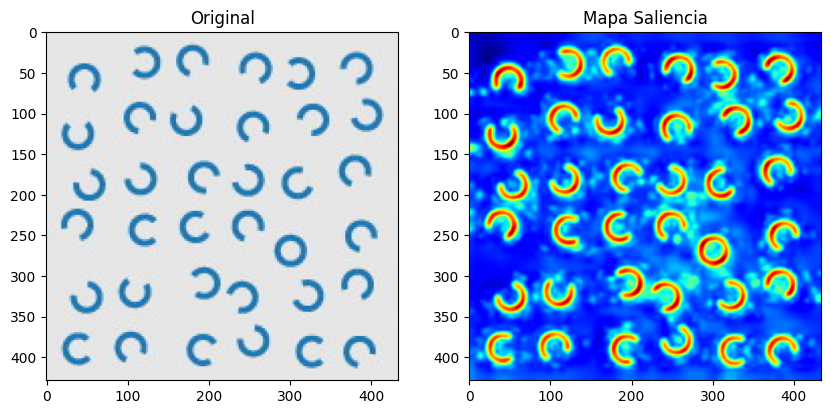

In [ ]:
# Cargar imagen
image = cv2.imread('test1.png')
dataPath = '../imaxes_pop-out_proba/'
imagesList = os.listdir(dataPath)

for imgName in imagesList:
    image = cv2.imread(dataPath+imgName, 1)

    # Inicialización
    image_width  = image.shape[1]
    image_height = image.shape[0]
    sm = pySaliencyMap.pySaliencyMap(image_width, image_height)

    # Computación
    saliency_map = sm.SMGetSM(image)

    # Visualización
    plt.figure(figsize=[10, 5])
    plt.subplot(1, 2, 1), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(1, 2, 2), plt.imshow(saliency_map, cmap='jet'), plt.title('Mapa Saliencia')
    plt.show()

### Construimos el modelo de la **gaussiana centrada** en la imagen simulando que es un mapa de saliencia.

#### Calculamos sigma y crearemos la gaussiana para convolucionarla posteriormente con el mapa de fijaciones humano y así crear nuestro mapa de saliencia.

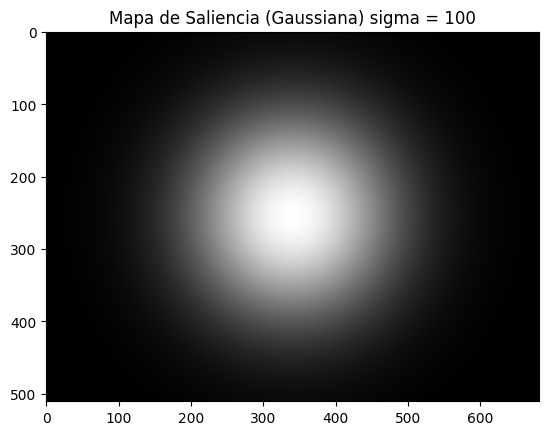

In [ ]:
# Función que crea la gaussiana
def CreateGaussian(shape, sigma):
    # Cuadrícula con las dimensiones dadas
    x, y = np.meshgrid(np.arange(0, shape[1]), np.arange(0, shape[0]))

    # Centro de la imagen
    center_x, center_y = shape[1] // 2, shape[0] // 2

    # Crear la gaussiana en el centro de la imagen
    gaussian = np.exp(-((x - center_x)**2 + (y - center_y)**2) / (2 * sigma**2))

    # Normalizar
    gaussian = cv2.normalize(gaussian, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return gaussian

# Definimos parámetros y creamos la gaussiana
shape = cv2.imread('./Imaxes/1.jpg', 1).shape
sigma = 100
gaussian_sm = CreateGaussian(shape, sigma)

# Visualizamos la gaussiana utilizada
plt.imshow(gaussian_sm, cmap='gray')
plt.title(f'Mapa de Saliencia (Gaussiana) sigma = {sigma}')
plt.show()

#### Definimos el directorio de la base de datos, las fijaciones y el número de imagenes a procesar.

In [ ]:
# Definimos el path a las imágenes de prueba
images_path = './Imaxes/'

# Definimos el path a los mapas de densidad
density_maps_path = './MapasDensidade/'

# Cargamos los mapas de fijación
fixation_maps = sio.loadmat('./origfixdata.mat')

# Definimos el número de imágenes a procesar
nimages = 120

### Creamos el modelo del **superhumano**

#### Para ello, primero debemos de construir la gaussiana que representará el campo de visión del humano que está viendo la pantalla con los datos proporcionados.

In [ ]:
def build_superhumanFOV(d=0.75, pulgadas_diagonal=21):  # Datos proporcionados
    d = d    # Distancia del sujeto a la pantalla (en metros)
    pulgadas_diagonal = pulgadas_diagonal  # Tamaño diagonal de la pantalla en pulgadas
    metros_diagonal = pulgadas_diagonal * 0.0254    # Convertir pulgadas a metros

    # Calcular el ángulo visual en radianes
    theta = 2 * np.arctan(metros_diagonal/(2*d))

    # Convertir radianes a grados
    sigma = np.degrees(theta)

    # Creamos la matriz 2D de la gaussiana
    size = int(2*np.ceil(3*sigma)+1)
    x = np.linspace(-(size//2), size//2, size)
    y = np.linspace(-(size//2), size//2, size)
    X, Y = np.meshgrid(x, y)
    gaussian = np.exp(-(X**2 + Y**2) / (2 * sigma**2))
    gaussian /= np.sum(gaussian)

    return gaussian

#### **Modelo 1**: utilizando como mapa de saliencia únicamente el mapa de fijaciones actual.

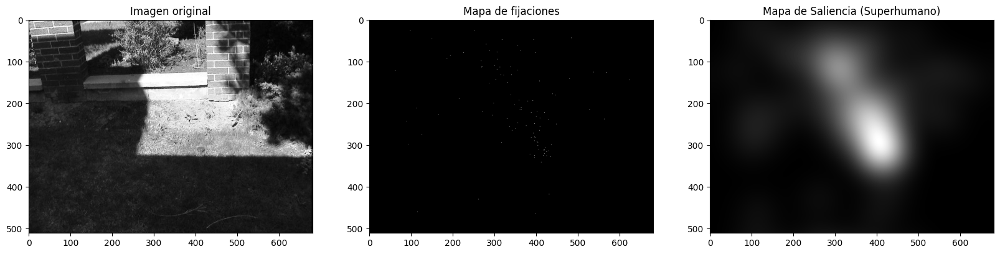

In [ ]:
# Leemos la imagen y el mapa de fijación correspondiente
numRandom = np.random.randint(0,nimages)
image = cv2.imread(str(images_path)+str(numRandom)+'.jpg', 0)
ground_truth = fixation_maps['white'][0,numRandom-1]*255

# Convertimos la imagen a tipo flotante para evitar problemas de saturación
ground_truth_float = ground_truth.astype(np.float32)

# Aplicamos la convolución
superhuman_sm = cv2.filter2D(ground_truth_float, -1, build_superhumanFOV(0.75, 21), borderType=cv2.BORDER_WRAP)

# Visualización
plt.figure(figsize=[20, 15])
plt.subplot(1, 3, 1), plt.imshow(image, cmap='gray'), plt.title('Imagen original')
plt.subplot(1, 3, 2), plt.imshow(ground_truth_float, cmap='gray'), plt.title('Mapa de fijaciones')
plt.subplot(1, 3, 3), plt.imshow(superhuman_sm, cmap='gray'), plt.title('Mapa de Saliencia (Superhumano)')
plt.show()

#### **Modelo 2**: utilizando como mapa de saliencia la suma de todos los mapas de fijaciones de la base de datos.

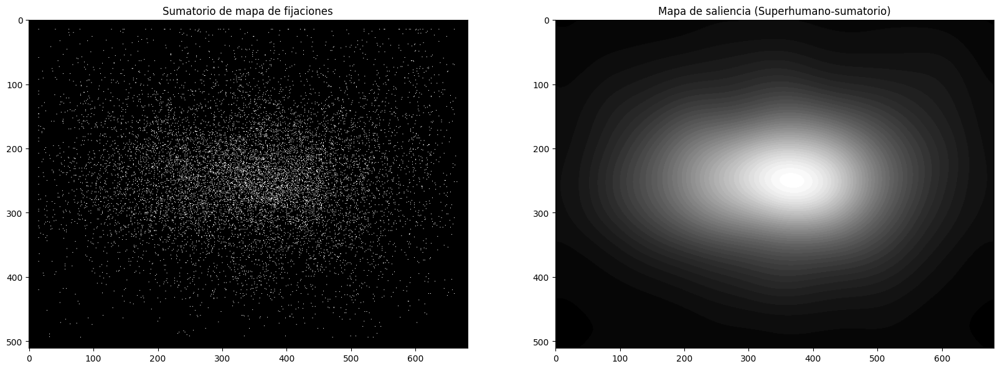

In [ ]:
# Inicializamos la variable donde sumaremos todos los mapas de fijaciones
SUMfixation_maps = 0

# Recorremos la base de datos
for i in range(1, nimages+1):
    # Leemos el mapa de fijación correspondiente y lo sumamos a la variable acumulativa
    ground_truth = fixation_maps['white'][0,i-1]*255
    SUMfixation_maps += ground_truth

# Aplicamos la convolución al sumatorio para obtener el mapa de saliencia
superhumanSUM_sm = cv2.filter2D(SUMfixation_maps, -1, build_superhumanFOV(0.75, 21), borderType=cv2.BORDER_WRAP)

# Visualización
plt.figure(figsize=[20, 15])
plt.subplot(1, 2, 1), plt.imshow(SUMfixation_maps, cmap='gray'), plt.title('Sumatorio de mapa de fijaciones')
plt.subplot(1, 2, 2), plt.imshow(superhumanSUM_sm, cmap='gray'), plt.title('Mapa de saliencia (Superhumano-sumatorio)')
plt.show()

## **Cálculo de las métricas**

#### En primer lugar definimos las funciones que calcularan las puntuaciones de cada mapa.

In [ ]:
def normalize_map(s_map):
	# normalize the salience map
	norm_s_map = (s_map - np.min(s_map))/((np.max(s_map)-np.min(s_map))*1.0)
	return norm_s_map

def discretize_gt(gt):
	return gt/255

def AUC_judd(s_map,gt):
	# ground truth is discrete, s_map is continous and normalized
	gt = discretize_gt(gt)
	s_map = normalize_map(s_map)
	# thresholds are calculated from the salience map, only at places where fixations are present
	thresholds = []
	for i in range(0,gt.shape[0]):
		for k in range(0,gt.shape[1]):
			if gt[i][k]>0:
				thresholds.append(s_map[i][k])

	num_fixations = np.sum(gt)
	# num fixations is no. of salience map values at gt >0
	thresholds = sorted(set(thresholds))
	#fp_list = []
	#tp_list = []
	area = []
	area.append((0.0,0.0))
	for thresh in thresholds:
		# in the salience map, keep only those pixels with values above threshold
		temp = np.zeros(s_map.shape)
		temp[s_map>=thresh] = 1.0
		num_overlap = np.where(np.add(temp,gt)==2)[0].shape[0]
		tp = num_overlap/(num_fixations*1.0)
		
		# total number of pixels > threshold - number of pixels that overlap with gt / total number of non fixated pixels
		# this becomes nan when gt is full of fixations..this won't happen
		fp = (np.sum(temp) - num_overlap)/((np.shape(gt)[0] * np.shape(gt)[1]) - num_fixations)
		
		area.append((round(tp,4),round(fp,4)))
		#tp_list.append(tp)
		#fp_list.append(fp)

	#tp_list.reverse()
	#fp_list.reverse()
	area.append((1.0,1.0))
	#tp_list.append(1.0)
	#fp_list.append(1.0)
	#print tp_list
	area.sort(key = lambda x:x[0])
	tp_list =  [x[0] for x in area]
	fp_list =  [x[1] for x in area]
	return np.trapz(np.array(tp_list),np.array(fp_list))

def AUC_shuff(s_map,gt,other_map,splits=100,stepsize=0.1):
	gt = discretize_gt(gt)
	other_map = discretize_gt(other_map)
	s_map = normalize_map(s_map)

	num_fixations = np.sum(gt)
	
	x,y = np.where(other_map==1)
	other_map_fixs = []
	for j in zip(x,y):
		other_map_fixs.append(j[0]*other_map.shape[0] + j[1])
	ind = len(other_map_fixs)
	assert ind == len(other_map_fixs), 'something is wrong in auc shuffle'


	num_fixations_other = min(ind,num_fixations)

	num_pixels = s_map.shape[0]*s_map.shape[1]
	random_numbers = []
	for i in range(0,splits):
		temp_list = []
		t1 = np.random.permutation(ind)
		for k in t1:
			temp_list.append(other_map_fixs[k])
		random_numbers.append(temp_list)	

	aucs = []
	# for each split, calculate auc
	for i in random_numbers:
		r_sal_map = []
		for k in i:
			#print('{}  {}'.format(k%s_map.shape[0]-1, int(np.floor(k/s_map.shape[0]))))
			r_sal_map.append(s_map[k%s_map.shape[0]-1, int(np.floor(k/s_map.shape[0]))])
		# in these values, we need to find thresholds and calculate auc
		thresholds = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]

		r_sal_map = np.array(r_sal_map)

		# once threshs are got
		thresholds = sorted(set(thresholds))
		area = []
		area.append((0.0,0.0))
		for thresh in thresholds:
			# in the salience map, keep only those pixels with values above threshold
			temp = np.zeros(s_map.shape)
			temp[s_map>=thresh] = 1.0
			num_overlap = np.where(np.add(temp,gt)==2)[0].shape[0]
			tp = num_overlap/(num_fixations*1.0)
			
			#fp = (np.sum(temp) - num_overlap)/((np.shape(gt)[0] * np.shape(gt)[1]) - num_fixations)
			# number of values in r_sal_map, above the threshold, divided by num of random locations = num of fixations
			fp = len(np.where(r_sal_map>thresh)[0])/(num_fixations*1.0)

			area.append((round(tp,4),round(fp,4)))
		
		area.append((1.0,1.0))
		area.sort(key = lambda x:x[0])
		tp_list =  [x[0] for x in area]
		fp_list =  [x[1] for x in area]

		aucs.append(np.trapz(np.array(tp_list),np.array(fp_list)))
	
	return np.mean(aucs)

def NSS(s_map,gt):
	gt = discretize_gt(gt)
	s_map_norm = (s_map - np.mean(s_map))/np.std(s_map)

	x,y = np.where(gt==1)
	temp = []
	for i in zip(x,y):
		temp.append(s_map_norm[i[0],i[1]])
	return np.mean(temp)


def CC(s_map,gt):
	s_map_norm = (s_map - np.mean(s_map))/np.std(s_map)
	gt_norm = (gt - np.mean(gt))/np.std(gt)
	a = s_map_norm
	b= gt_norm
	r = (a*b).sum() / np.sqrt((a*a).sum() * (b*b).sum())
	return r

#### Además definimos las funciones que calcularán los mapas de saliencia mediante los métodos del residuo espectral y fase global. Los definimos otra vez aquí para modificarle el valor de la amplitud de la gaussiana.

In [ ]:
WIDTH = 64

# Función para calcular el mapa de saliencia basado en el residuo espectral considerando información de color e invariante a la escala
def SR_Color_Multiescala(img, num_scales=1):
    rows, cols = img.shape[0], img.shape[1]
    img = cv2.resize(img, (WIDTH,int(WIDTH*img.shape[0]/img.shape[1])))

    # Crear la pirámide gaussiana
    pyramid = [img]
    for _ in range(num_scales-1):
        img = cv2.pyrDown(img)
        pyramid.append(img)

    # Lista en la que se almacenarán los mapas de saliencia a distintas escalas
    smSS = []

    for scaled_img in pyramid:
        # Si es una imagen en escala de grises (no se puede obtener información de color) 
        if len(scaled_img.shape) == 2:
            # Transformada de Fourier
            c = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
            mag = np.sqrt(c[:, :, 0] ** 2 + c[:, :, 1] ** 2)
            spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))

            # Aplicación del residuo espectral en el dominio de la frecuencia
            c[:, :, 0] = c[:, :, 0] * spectralResidual / mag
            c[:, :, 1] = c[:, :, 1] * spectralResidual / mag
            c = cv2.dft(c, flags=(cv2.DFT_INVERSE | cv2.DFT_SCALE))
            mag = c[:, :, 0] ** 2 + c[:, :, 1] ** 2

            # Suavizado y redimensionado
            sm = cv2.resize(cv2.GaussianBlur(mag,(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

        # Si es una imagen a color
        else:
            # Obtener los canales de color
            # Cambiamos los canales de color a LAB
            scaled_img = cv2.cvtColor(scaled_img, cv2.COLOR_BGR2LAB)
            channels = [scaled_img[:, :, 0], scaled_img[:, :, 1], scaled_img[:, :, 2]]
            results = []

            # Para cada canal
            for i in range(len(channels)):
                # Transformada de Fourier para el canal actual
                c = cv2.dft(np.float32(channels[i]), flags=cv2.DFT_COMPLEX_OUTPUT)
                mag = np.sqrt(c[:, :, 0] ** 2 + c[:, :, 1] ** 2)
                spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))

                # Aplicación del residuo espectral al canal en el dominio de la frecuencia
                c[:, :, 0] = c[:, :, 0] * spectralResidual / mag
                c[:, :, 1] = c[:, :, 1] * spectralResidual / mag
                c = cv2.dft(c, flags=(cv2.DFT_INVERSE | cv2.DFT_SCALE))
                mag = c[:, :, 0] ** 2 + c[:, :, 1] ** 2

                # Suavizado y redimensionado
                sm_channel = cv2.resize(cv2.GaussianBlur(mag,(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

                # Agregamos el mapa de saliencia del canal actual a la lista
                results.append(sm_channel)

            # Sumamos los mapas de saliencia de cada canal de color
            sm = np.sum(results, axis=0)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

    # Reconstruir la imagen con las pirámides
    sm_ = smSS[0]
    for i in range(1, len(smSS)+1):
        smSS[-i] = cv2.resize(smSS[-i], (cols, rows), cv2.NORM_MINMAX)
        sm_ = np.add(sm_, smSS[-i])

    # Normalización
    sm_norm = cv2.normalize(sm_, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return sm_norm


# Función para calcular el mapa de saliencia basado en el espectro de fase de la transformada de Fourier
def PFT_Color_Multiescala(img, num_scales=1):
    rows, cols = img.shape[0], img.shape[1]
    img = cv2.resize(img, (WIDTH,int(WIDTH*img.shape[0]/img.shape[1])))

    # Crear la pirámide gaussiana
    pyramid = [img]
    for _ in range(num_scales-1):
        img = cv2.pyrDown(img)
        pyramid.append(img)

    # Lista en la que se almacenarán los mapas de saliencia a distintas escalas
    smSS = []

    for scaled_img in pyramid:
        # Si es una imagen en escala de grises, no podemos obtener información de los colores 
        if len(img.shape) == 2:
            # Transformada de Fourier
            img_fft = np.fft.fft2(img)

            # Espectro de la fase de la imagen
            phase_espectrum = np.angle(img_fft)

            # Suavizado y redimensionado del mapa de saliencia
            sm = cv2.resize(cv2.GaussianBlur((np.abs(np.fft.ifft2(np.exp(1j * phase_espectrum)))**2),(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

        # Si es una imagen a color
        else:
            # Obtener los canales de color
            # Cambiamos los canales de color a LAB
            scaled_img = cv2.cvtColor(scaled_img, cv2.COLOR_BGR2LAB)
            channels = [scaled_img[:, :, 0], scaled_img[:, :, 1], scaled_img[:, :, 2]]
            results = []

            # Para cada canal
            for i in range(len(channels)):
                # Transformada de Fourier
                img_fft = np.fft.fft2(channels[i])

                # Espectro de la fase de la imagen
                phase_espectrum = np.angle(img_fft)

                # Suavizado y redimensionado del mapa de saliencia para el canal actual
                sm_channel = cv2.resize(cv2.GaussianBlur((np.abs(np.fft.ifft2(np.exp(1j * phase_espectrum)))**2),(9,9),3,3), (cols, rows), cv2.NORM_MINMAX)

                # Agregamos el mapa de saliencia del canal actual a la lista
                results.append(sm_channel)

            # Sumamos los mapas de saliencia de cada canal de color
            sm = np.sum(results, axis=0)

            # Introducimos el mapa de saliencia para la escala actual en la lista
            smSS.append(sm)

    # Reconstruir la imagen con las pirámides
    sm_ = smSS[0]
    for i in range(1, len(smSS)+1):
        smSS[-i] = cv2.resize(smSS[-i], (cols, rows), cv2.NORM_MINMAX)
        sm_ = np.add(sm_, smSS[-i])

    # Normalización
    sm_norm = cv2.normalize(sm_, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return sm_norm

#### **Residuo espectral (SR) SIN color**

In [ ]:
SR_sms = []
SR_AUCjudd_scores = []
SR_AUCshuff_scores = []
SR_NSS_scores = []
SR_CC_scores = []

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 0)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Obtenemos el mapa de saliencia
    sm_re = SR_Color_Multiescala(image)
    SR_sms.append(sm_re)

    # Calculamos las diferentes metricas
    SR_AUCjudd_scores.append(AUC_judd(sm_re, ground_truth))
    SR_AUCshuff_scores.append(AUC_shuff(sm_re, ground_truth, random_ground_truth))
    SR_NSS_scores.append(NSS(sm_re, ground_truth))
    SR_CC_scores.append(CC(sm_re, density_map))

# Calculamos la media de las métricas
SR_AUCjudd_mean = np.mean(np.nan_to_num(SR_AUCjudd_scores))
SR_AUCshuff_mean = np.mean(np.nan_to_num(SR_AUCshuff_scores))
SR_NSS_mean = np.mean(np.nan_to_num(SR_NSS_scores))
SR_CC_mean = np.mean(np.nan_to_num(SR_CC_scores))

#### **Residuo espectral (SR) CON color**

In [ ]:
SRColor_sms = []
SRColor_AUCjudd_scores = []
SRColor_AUCshuff_scores = []
SRColor_NSS_scores = []
SRColor_CC_scores = []

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 1)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Obtenemos el mapa de saliencia
    sm_re = SR_Color_Multiescala(image)
    SRColor_sms.append(sm_re)

    # Calculamos las diferentes metricas
    SRColor_AUCjudd_scores.append(AUC_judd(sm_re, ground_truth))
    SRColor_AUCshuff_scores.append(AUC_shuff(sm_re, ground_truth, random_ground_truth))
    SRColor_NSS_scores.append(NSS(sm_re, ground_truth))
    SRColor_CC_scores.append(CC(sm_re, density_map))

# Calculamos la media de las métricas
SRColor_AUCjudd_mean = np.mean(np.nan_to_num(SRColor_AUCjudd_scores))
SRColor_AUCshuff_mean = np.mean(np.nan_to_num(SRColor_AUCshuff_scores))
SRColor_NSS_mean = np.mean(np.nan_to_num(SRColor_NSS_scores))
SRColor_CC_mean = np.mean(np.nan_to_num(SRColor_CC_scores))

/tmp/ipykernel_27360/3162429601.py:50: RuntimeWarning: divide by zero encountered in log
  spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))
/tmp/ipykernel_27360/3162429601.py:50: RuntimeWarning: invalid value encountered in subtract
  spectralResidual = np.exp(np.log(mag) - cv2.boxFilter(np.log(mag), -1, (3, 3)))
/tmp/ipykernel_27360/3162429601.py:77: RuntimeWarning: invalid value encountered in cast
  sm_norm = cv2.normalize(sm_, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
/tmp/ipykernel_27360/1916560951.py:3: RuntimeWarning: invalid value encountered in divide
  norm_s_map = (s_map - np.min(s_map))/((np.max(s_map)-np.min(s_map))*1.0)
/tmp/ipykernel_27360/1916560951.py:119: RuntimeWarning: invalid value encountered in divide
  s_map_norm = (s_map - np.mean(s_map))/np.std(s_map)
/tmp/ipykernel_27360/1916560951.py:129: RuntimeWarning: invalid value encountered in divide
  s_map_norm = (s_map - np.mean(s_map))/np.std(s_map)


#### **Fase global (PFT) SIN color**

In [ ]:
PFT_sms = []
PFT_AUCjudd_scores = []
PFT_AUCshuff_scores = []
PFT_NSS_scores = []
PFT_CC_scores = []

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 0)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Obtenemos el mapa de saliencia
    sm_fg = PFT_Color_Multiescala(image)
    PFT_sms.append(sm_fg)

    # Calculamos las diferentes metricas
    PFT_AUCjudd_scores.append(AUC_judd(sm_fg, ground_truth))
    PFT_AUCshuff_scores.append(AUC_shuff(sm_fg, ground_truth, random_ground_truth))
    PFT_NSS_scores.append(NSS(sm_fg, ground_truth))
    PFT_CC_scores.append(CC(sm_fg, density_map))

# Calculamos la media de las métricas
PFT_AUCjudd_mean = np.mean(np.nan_to_num(PFT_AUCjudd_scores))
PFT_AUCshuff_mean = np.mean(np.nan_to_num(PFT_AUCshuff_scores))
PFT_NSS_mean = np.mean(np.nan_to_num(PFT_NSS_scores))
PFT_CC_mean = np.mean(np.nan_to_num(PFT_CC_scores))

#### **Fase global (PFT) CON color**

In [ ]:
PFTColor_sms = []
PFTColor_AUCjudd_scores = []
PFTColor_AUCshuff_scores = []
PFTColor_NSS_scores = []
PFTColor_CC_scores = []

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 1)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Obtenemos el mapa de saliencia
    sm_fg = PFT_Color_Multiescala(image)
    PFTColor_sms.append(sm_fg)

    # Calculamos las diferentes metricas
    PFTColor_AUCjudd_scores.append(AUC_judd(sm_fg, ground_truth))
    PFTColor_AUCshuff_scores.append(AUC_shuff(sm_fg, ground_truth, random_ground_truth))
    PFTColor_NSS_scores.append(NSS(sm_fg, ground_truth))
    PFTColor_CC_scores.append(CC(sm_fg, density_map))

# Calculamos la media de las métricas
PFTColor_AUCjudd_mean = np.mean(np.nan_to_num(PFTColor_AUCjudd_scores))
PFTColor_AUCshuff_mean = np.mean(np.nan_to_num(PFTColor_AUCshuff_scores))
PFTColor_NSS_mean = np.mean(np.nan_to_num(PFTColor_NSS_scores))
PFTColor_CC_mean = np.mean(np.nan_to_num(PFTColor_CC_scores))

#### **Itti**

In [ ]:
Itti_sms = []
Itti_AUCjudd_scores = []
Itti_AUCshuff_scores = []
Itti_NSS_scores = []
Itti_CC_scores = []

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 1)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Obtenemos el mapa de saliencia
    # Inicialización
    image_width  = image.shape[1]
    image_height = image.shape[0]
    sm = pySaliencyMap.pySaliencyMap(image_width, image_height)

    # Computación
    sm_Itti = sm.SMGetSM(image)
    Itti_sms.append(sm_Itti)

    # Calculamos las diferentes metricas
    Itti_AUCjudd_scores.append(AUC_judd(sm_Itti, ground_truth))
    Itti_AUCshuff_scores.append(AUC_shuff(sm_Itti, ground_truth, random_ground_truth))
    Itti_NSS_scores.append(NSS(sm_Itti, ground_truth))
    Itti_CC_scores.append(CC(sm_Itti, density_map))

# Calculamos la media de las métricas
Itti_AUCjudd_mean = np.mean(np.nan_to_num(Itti_AUCjudd_scores))
Itti_AUCshuff_mean = np.mean(np.nan_to_num(Itti_AUCshuff_scores))
Itti_NSS_mean = np.mean(np.nan_to_num(Itti_NSS_scores))
Itti_CC_mean = np.mean(np.nan_to_num(Itti_CC_scores))

#### **Gaussiana centrada**

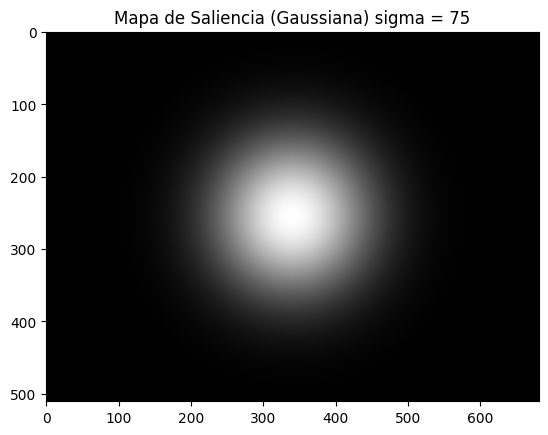

In [ ]:
gaussian_AUCjudd_scores = []
gaussian_AUCshuff_scores = []
gaussian_NSS_scores = []
gaussian_CC_scores = []

# Definimos parámetros y creamos la gaussiana
# Como todas las imágenes tienen las mismas dimensiones, solo cargamos la gaussiana 1 vez para ahorrar recursos
shape = cv2.imread('./Imaxes/1.jpg', 1).shape
print(shape)
sigma = 75
gaussian_sm = CreateGaussian(shape, sigma)

# Recorremos la base de datos con las imágenes iniciales
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 0)
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Calculamos las diferentes metricas
    gaussian_AUCjudd_scores.append(AUC_judd(gaussian_sm, ground_truth))
    gaussian_AUCshuff_scores.append(AUC_shuff(gaussian_sm, ground_truth, random_ground_truth))
    gaussian_NSS_scores.append(NSS(gaussian_sm, ground_truth))
    gaussian_CC_scores.append(CC(gaussian_sm, density_map))

# Calculamos la media de las métricas
gaussian_AUCjudd_mean = np.mean(np.nan_to_num(gaussian_AUCjudd_scores))
gaussian_AUCshuff_mean = np.mean(np.nan_to_num(gaussian_AUCshuff_scores))
gaussian_NSS_mean = np.mean(np.nan_to_num(gaussian_NSS_scores))
gaussian_CC_mean = np.mean(np.nan_to_num(gaussian_CC_scores))

# Visualizamos la gaussiana utilizada
plt.imshow(gaussian_sm, cmap='gray')
plt.title(f'Mapa de Saliencia (Gaussiana) sigma = {sigma}')
plt.show()

##### Pruebas con distintas amplitudes de la gaussiana:

In [ ]:
# Descomentar para ejecutar (tarda mucho tiempo, aprox. 50 min.)
"""# Definimos las listas para almacenar los valores de las métricas
AUCj_values = []
AUCshuff_values = []
NSS_values = []
CC_values = []

# Definimos los valores de sigma con un intervalo de 25
sigmas = [1, 25, 50, 75, 100, 125, 150, 175, 200]

# Iteramos sobre los diferentes valores de sigma
for sigma in sigmas:
    gaussian_AUCjudd_total = 0
    gaussian_AUCshuff_total = 0
    gaussian_NSS_total = 0
    gaussian_CC_total = 0
    gaussian_AUCjudd_scores = []
    gaussian_AUCshuff_scores = []
    gaussian_NSS_scores = []
    gaussian_CC_scores = []

    # Definimos parámetros y creamos la gaussiana
    shape = cv2.imread('./Imaxes/1.jpg', 1).shape
    gaussian_sm = CreateGaussian(shape, sigma)

    # Recorremos la base de datos con las imágenes iniciales
    for i in range(1, nimages+1):
        # Leemos la imagen y el mapa de fijación correspondiente
        image = cv2.imread(str(images_path)+str(i)+'.jpg', 0)
        ground_truth = fixation_maps['white'][0,i-1]*255
        random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255

        # Calculamos las diferentes metricas
        AUCj_score = AUC_judd(gaussian_sm, ground_truth)
        gaussian_AUCjudd_scores.append(AUCj_score)
        gaussian_AUCjudd_total += AUCj_score

        AUCshuff_score = AUC_shuff(gaussian_sm, ground_truth, random_ground_truth)
        gaussian_AUCshuff_scores.append(AUCshuff_score)
        gaussian_AUCshuff_total += AUCshuff_score

        NSS_score = NSS(gaussian_sm, ground_truth)
        gaussian_NSS_scores.append(NSS_score)
        gaussian_NSS_total += NSS_score

        CC_score = CC(gaussian_sm, ground_truth)
        gaussian_CC_scores.append(CC_score)
        gaussian_CC_total += CC_score

    # Calculamos la media de las métricas y las almacenamos en las listas correspondientes
    AUCj_values.append(gaussian_AUCjudd_total/nimages)
    AUCshuff_values.append(gaussian_AUCshuff_total/nimages)
    NSS_values.append(gaussian_NSS_total/nimages)
    CC_values.append(gaussian_CC_total/nimages)

# Creamos el DataFrame con las métricas
data = {
    'Sigma Value':sigmas,
    'AUCjudd':AUCj_values,
    'AUCshuff':AUCshuff_values,
    'NSS':NSS_values,
    'CC':CC_values
}

df = pd.DataFrame(data)

# Seleccionamos las columnas de interés para el gráfico de líneas
x = df['Sigma Value']
y1 = df['AUCjudd']
y2 = df['AUCshuff']
y3 = df['NSS']
y4 = df['CC']

# Creamos subplots separados para cada métrica
fig, axs = plt.subplots(4, 1, figsize=(10, 20))

# Graficamos cada métrica en su propio subplot
axs[0].plot(x, y1, marker='o', label='AUC judd', color='blue')
axs[0].set_title('AUC judd')
axs[0].set_xlabel('Valor sigma')
axs[0].set_ylabel('Valor métrica')
axs[0].grid(True)

axs[1].plot(x, y2, marker='o', label='AUC shuffled', color='orange')
axs[1].set_title('AUC shuffled')
axs[1].set_xlabel('Valor sigma')
axs[1].set_ylabel('Valor métrica')
axs[1].grid(True)

axs[2].plot(x, y3, marker='o', label='NSS', color='green')
axs[2].set_title('NSS')
axs[2].set_xlabel('Valor sigma')
axs[2].set_ylabel('Valor métrica')
axs[2].grid(True)

axs[3].plot(x, y4, marker='o', label='CC', color='red')
axs[3].set_title('CC')
axs[3].set_xlabel('Valor sigma')
axs[3].set_ylabel('Valor métrica')
axs[3].grid(True)

plt.tight_layout()
plt.show()"""

"# Definimos las listas para almacenar los valores de las métricas\nAUCj_values = []\nAUCshuff_values = []\nNSS_values = []\nCC_values = []\n\n# Definimos los valores de sigma con un intervalo de 25\nsigmas = [1, 25, 50, 75, 100, 125, 150, 175, 200]\n\n# Iteramos sobre los diferentes valores de sigma\nfor sigma in sigmas:\n    gaussian_AUCjudd_total = 0\n    gaussian_AUCshuff_total = 0\n    gaussian_NSS_total = 0\n    gaussian_CC_total = 0\n    gaussian_AUCjudd_scores = []\n    gaussian_AUCshuff_scores = []\n    gaussian_NSS_scores = []\n    gaussian_CC_scores = []\n\n    # Definimos parámetros y creamos la gaussiana\n    shape = cv2.imread('./Imaxes/1.jpg', 1).shape\n    gaussian_sm = CreateGaussian(shape, sigma)\n\n    # Recorremos la base de datos con las imágenes iniciales\n    for i in range(1, nimages+1):\n        # Leemos la imagen y el mapa de fijación correspondiente\n        image = cv2.imread(str(images_path)+str(i)+'.jpg', 0)\n        ground_truth = fixation_maps['white'][0

##### En este modelo se realizaron varias pruebas con distintos valores de sigma (amplitud de la gaussiana) para ver como variaban las métricas. El resultado de ejecutar la celda de arriba es el siguiente:
<img src="./results/Estatica/GaussianMetricsGraph.png">

#### Análisis
Observando los resultados se puede ver que, a medida que aumentamos el tamaño de la gaussiana, los valores de las medidas incrementan hasta llegar a un valor cercano a 100, a partir de este punto las métricas se comportan de manera distinta:
- AUC judd: A partir de un tamaño de gaussiana mayor a 25 el valor se mantiene constante (saturada), esto se debe a que, si nuestra predicción está en el lugar de nuestro ground truth, esta métrica tendrá un valor elevado (aunque el tamaño de la predicción sea mayor que la fijación). Se trata de una métrica invariante a transformaciones monótonas.
- AUC shuffled: Por lo general, su valor aumenta a medida que aumenta la amplitud de la gaussiana hasta que se estabiliza en un valor similar al de AUC judd cuando su valor es próximo a 75-100, sin embargo, nunca debería de exceder el valor de AUC judd, ya que se trata de una versión de esta que compensa el sesgo del conjunto de datos al puntuar una prioridad central al azar. Es más apropiado en entornos de evaluación donde no se espera que el modelo de saliencia tenga en cuenta el sesgo central. De lo contrario, tiene propiedades similares a AUC judd.
- NSS: Su valor aumenta hasta un valor de sigma cercano a 100, a partir de este, su valor comienza a disminuir. Se trata de una aproximación de CC que además no tiene parámetros (opera en ubicaciones de fijación sin procesar).
- CC: El comportamiento es similar al de la métrica NSS. Es una correlación lineal entre la predicción y el ground truth. Toma los falsos positivos y los falsos negativos de manera simetrica.

Tanto en la gráfica de la métrica NSS como en la de CC es donde mejor se puede comprobar el rendimiento de este modelo a medida que aumentamos la amplitud de la gaussiana, obteniendo como resultado un valor de sigma óptimo cercano a 100.

Como conclusión general del modelo simulado, su uso nos puede proporcionar información sobre la base de datos de las imágenes, ya que este modelo espera que el objeto saliente de las imágenes se encuentre situado en el centro de esta y no en un extremo.

#### **Superhumano** (construido únicamente con el mapa de fijaciones actual)

In [ ]:
superhuman_AUCjudd_scores = []
superhuman_AUCshuff_scores = []
superhuman_NSS_scores = []
superhuman_CC_scores = []

# Convolucionamos la gaussiana con cada mapa de fijaciones y lo utilizamos como mapa de saliencia
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Convertimos la imagen a tipo flotante para evitar problemas de saturación
    ground_truth_float = ground_truth.astype(np.float32)

    # Aplicamos la convolución
    superhuman_sm = cv2.filter2D(ground_truth_float, -1, build_superhumanFOV(0.75, 21), borderType=cv2.BORDER_WRAP)

    # Calculamos las diferentes metricas
    superhuman_AUCjudd_scores.append(AUC_judd(superhuman_sm, ground_truth))
    superhuman_AUCshuff_scores.append(AUC_shuff(superhuman_sm, ground_truth, random_ground_truth))
    superhuman_NSS_scores.append(NSS(superhuman_sm, ground_truth))
    superhuman_CC_scores.append(CC(superhuman_sm, density_map))

# Calculamos la media de las métricas
superhuman_AUCjudd_mean = np.mean(np.nan_to_num(superhuman_AUCjudd_scores))
superhuman_AUCshuff_mean = np.mean(np.nan_to_num(superhuman_AUCshuff_scores))
superhuman_NSS_mean = np.mean(np.nan_to_num(superhuman_NSS_scores))
superhuman_CC_mean = np.mean(np.nan_to_num(superhuman_CC_scores))

#### **Superhumano** (construido con la suma de todos los mapas de fijaciones)

In [ ]:
# Construimos el mapa de saliencia del superhumano previamente ya que será invariante a lo largo del análisis
# Inicializamos la variable donde sumaremos todos los mapas de fijaciones
SUMfixation_maps = 0

# Recorremos la base de datos
for i in range(1, nimages+1):
    # Leemos el mapa de fijación correspondiente y lo sumamos a la variable acumulativa
    ground_truth = fixation_maps['white'][0,i-1]*255
    SUMfixation_maps += ground_truth

# Aplicamos la convolución al sumatorio para obtener el mapa de saliencia
superhumanSUM_sm = cv2.filter2D(SUMfixation_maps, -1, build_superhumanFOV(0.75, 21), borderType=cv2.BORDER_WRAP)


superhumanSUM_AUCjudd_scores = []
superhumanSUM_AUCshuff_scores = []
superhumanSUM_NSS_scores = []
superhumanSUM_CC_scores = []

# Convolucionamos la gaussiana con cada mapa de fijaciones y lo utilizamos como mapa de saliencia
for i in range(1, nimages+1):
    # Leemos la imagen, el mapa de fijación correspondiente y otro aleatorio y el mapa de densidad
    ground_truth = fixation_maps['white'][0,i-1]*255
    random_ground_truth = fixation_maps['white'][0,np.random.randint(0,nimages)]*255
    density_map = cv2.imread(str(density_maps_path)+'d'+str(i)+'.jpg', 0)

    # Calculamos las diferentes metricas
    superhumanSUM_AUCjudd_scores.append(AUC_judd(superhumanSUM_sm, ground_truth))
    superhumanSUM_AUCshuff_scores.append(AUC_shuff(superhumanSUM_sm, ground_truth, random_ground_truth))
    superhumanSUM_NSS_scores.append(NSS(superhumanSUM_sm, ground_truth))
    superhumanSUM_CC_scores.append(CC(superhumanSUM_sm, density_map))

# Calculamos la media de las métricas
superhumanSUM_AUCjudd_mean = np.mean(np.nan_to_num(superhumanSUM_AUCjudd_scores))
superhumanSUM_AUCshuff_mean = np.mean(np.nan_to_num(superhumanSUM_AUCshuff_scores))
superhumanSUM_NSS_mean = np.mean(np.nan_to_num(superhumanSUM_NSS_scores))
superhumanSUM_CC_mean = np.mean(np.nan_to_num(superhumanSUM_CC_scores))

## **Resultados de las métricas:**

In [ ]:
print('Número de imágenes muestreadas: {}'.format(nimages))

# Listas
metrics = ['AUCjudd', 'AUCshuff', 'NSS', 'CC']
models = ['SR', 'SR+Color', 'PFT', 'PFT+Color', 'Itti', 'Gaussian', 'Superhuman', 'SuperhumanSUM']
score_lists = [
    [SR_AUCjudd_mean, SRColor_AUCjudd_mean, PFT_AUCjudd_mean, PFTColor_AUCjudd_mean, Itti_AUCjudd_mean, gaussian_AUCjudd_mean, superhuman_AUCjudd_mean, superhumanSUM_AUCjudd_mean],
    [SR_AUCshuff_mean, SRColor_AUCshuff_mean, PFT_AUCshuff_mean, PFTColor_AUCshuff_mean, Itti_AUCshuff_mean, gaussian_AUCshuff_mean, superhuman_AUCshuff_mean, superhumanSUM_AUCshuff_mean],
    [SR_NSS_mean, SRColor_NSS_mean, PFT_NSS_mean, PFTColor_NSS_mean, Itti_NSS_mean, gaussian_NSS_mean, superhuman_NSS_mean, superhumanSUM_NSS_mean],
    [SR_CC_mean, SRColor_CC_mean, PFT_CC_mean, PFTColor_CC_mean, Itti_CC_mean, gaussian_CC_mean, superhuman_CC_mean, superhumanSUM_CC_mean]
]

# Dataframe con las métricas
data = {'Modelo': models}
for metric, score_list in zip(metrics, score_lists):
    sorted_scores = sorted(score_list, reverse=True)
    data[metric] = score_list
    data[f'{metric.rjust(2)} Rank'] = [sorted_scores.index(score) + 1 for score in score_list]

df = pd.DataFrame(data)

# Mostramos el DataFrame
df

Número de imágenes muestreadas: 120


,Modelo,AUCjudd,AUCjudd Rank,AUCshuff,AUCshuff Rank,NSS,NSS Rank,CC,CC Rank
0,SR,0.716305,7,0.709764,4,0.857871,7,0.302076,7
1,SR+Color,0.740994,5,0.711933,3,1.131600,5,0.392849,5
2,PFT,0.719145,6,0.695197,6,0.866032,6,0.305225,6
3,PFT+Color,0.756686,4,0.735976,2,1.230009,3,0.426898,4
4,Itti,0.697763,8,0.659993,7,0.818322,8,0.269645,8
5,Gaussian,0.779969,3,0.639668,8,1.207538,4,0.476980,3
6,Superhuman,0.918044,1,0.851752,1,2.523987,1,0.923179,1
7,SuperhumanSUM,0.807072,2,0.708225,5,1.325452,2,0.524797,2


### Análisis de los resultados
Observando los resultados podemos comprobar que el modelo del superhumano que utiliza el mapa de densidades de la imagen actual como mapa de saliencia es el que mejores valores de métricas presenta, lo cual era algo de esperar. Por detrás lo sigue el modelo del superhumano que toma todos los mapas de fijaciones y los suma en uno único para utilizarlo como mapa de saliencia global.

En cuanto al resto de los modelos, tanto en el del residuo espectral (SR) como en el de la fase global (PFT) vemos unos valores muy similares debido a su similar funcionamiento. A su vez, podemos comprobar que hay un ligero incremento en el rendimiento de éstos al incluirles información de color e invarianza a escala, lo que nos sugiere que estos cambios en los algoritmos son beneficiosos a la hora de generar los mapas de saliencia. Sin embargo, el modelo de Itti, que también toma información de los canales de color de las imágenes para generar el mapa de saliencia, presenta el valor más bajo en la mayoría de las métricas, no obstante, esto no se debe a que el algoritmo funcione mal, sino que deberíamos de ajustar el valor de la amplitud de la gaussiana con la que convolucionamos el mapa de saliencia para suavizarlo más.

Por otro lado, el modelo de la gaussiana centrada en la imagen presenta el último puesto en el ranking dado que se trata de un modelo generalizado que no tiene en cuenta ningún factor de la imagen de entrada, únicamente intuye que el objeto saliente en la imagen estará situado en el centro de ésta.

Cabe destacar los resultados de la métrica CC en el modelo del superhumano que utiliza el mapa de fijaciones de la imagen actual, ya que nos da un resultado de 0.92, muy cercano a 1, que se trataría de una correlación casi perfecta, lo cual es lógico ya que lo única diferencia entre el mapa de saliencia y el ground truth que estamos comparando es la gaussiana que se convoluciona con las fijaciones de la imagen.

## Visualización de los 3 mejores y los 3 peores casos para cada modelo y métrica.

In [ ]:
# Este código es simplemente para almacenar las imágenes en una lista para su uso posterior
images = []
for i in range(1, nimages+1):
    image = cv2.imread(str(images_path)+str(i)+'.jpg', 1)
    images.append(image)

#### **Residuo espectral SIN color (SR)**

##### **AUC judd**

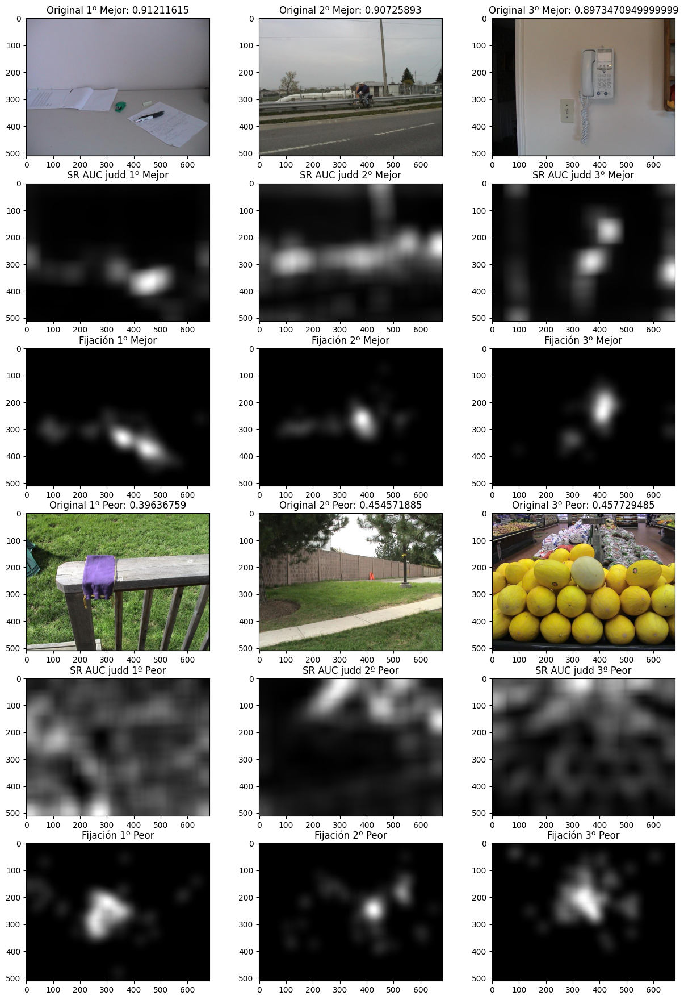

In [ ]:
# Organizar los resultados de AUC en orden ascendente
SR_sorted_sms = sorted(SR_AUCjudd_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(SR_sorted_sms[len(SR_AUCjudd_scores)-3:len(SR_AUCjudd_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = SR_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SR_AUCjudd_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SR_sms[SR_AUCjudd_scores.index((best3)[i])], cmap='gray'), plt.title('SR AUC judd {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_AUCjudd_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SR_AUCjudd_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SR_sms[SR_AUCjudd_scores.index((worst3)[i])], cmap='gray'), plt.title('SR AUC judd {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_AUCjudd_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **AUC shuffled**

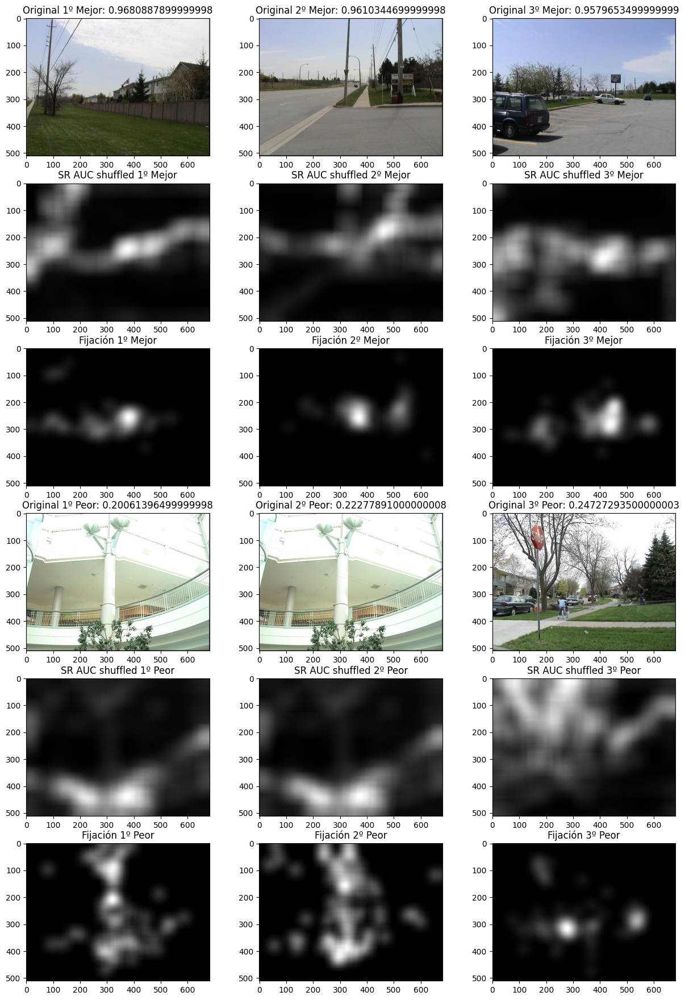

In [ ]:
# Organizar los resultados de AUC en orden ascendente
SR_sorted_sms = sorted(SR_AUCshuff_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(SR_sorted_sms[len(SR_AUCshuff_scores)-3:len(SR_AUCshuff_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = SR_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SR_AUCshuff_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SR_sms[SR_AUCshuff_scores.index((best3)[i])], cmap='gray'), plt.title('SR AUC shuffled {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_AUCshuff_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SR_AUCshuff_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SR_sms[SR_AUCshuff_scores.index((worst3)[i])], cmap='gray'), plt.title('SR AUC shuffled {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_AUCshuff_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **NSS**

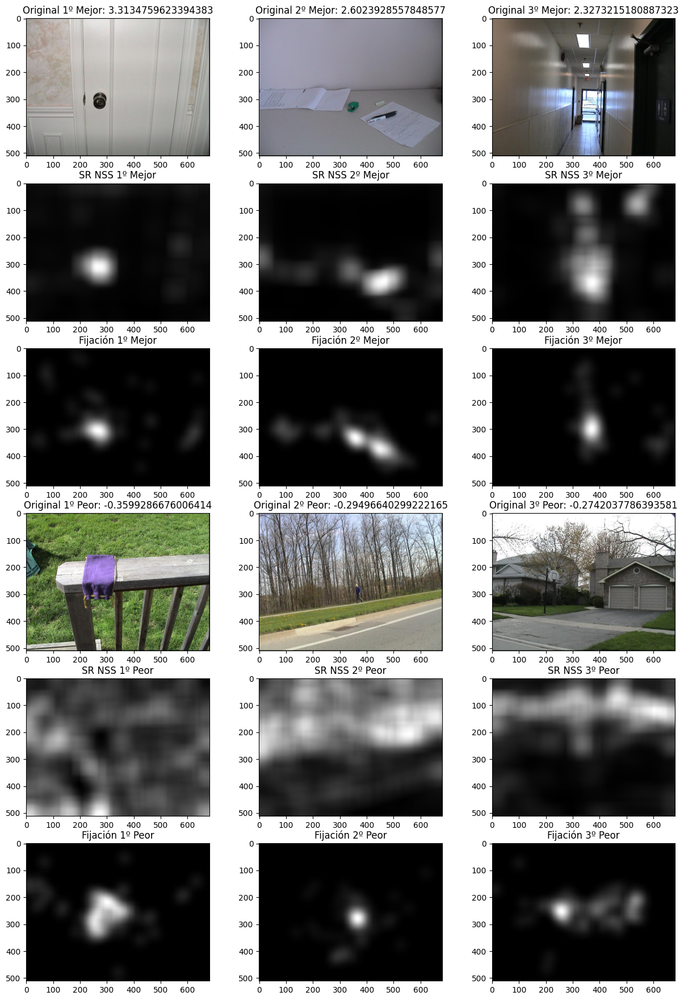

In [ ]:
# Organizar los resultados de NSS en orden ascendente
SR_sorted_sms = sorted(SR_NSS_scores)

# Seleccionar los tres mejores resultados de NSS y ordenarlos de forma descendente
best3 = sorted(SR_sorted_sms[len(SR_NSS_scores)-3:len(SR_NSS_scores)])[::-1]

# Seleccionar los tres peores resultados de NSS y ordenarlos de forma descendente
worst3 = SR_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SR_NSS_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SR_sms[SR_NSS_scores.index((best3)[i])], cmap='gray'), plt.title('SR NSS {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_NSS_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SR_NSS_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SR_sms[SR_NSS_scores.index((worst3)[i])], cmap='gray'), plt.title('SR NSS {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_NSS_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **CC**

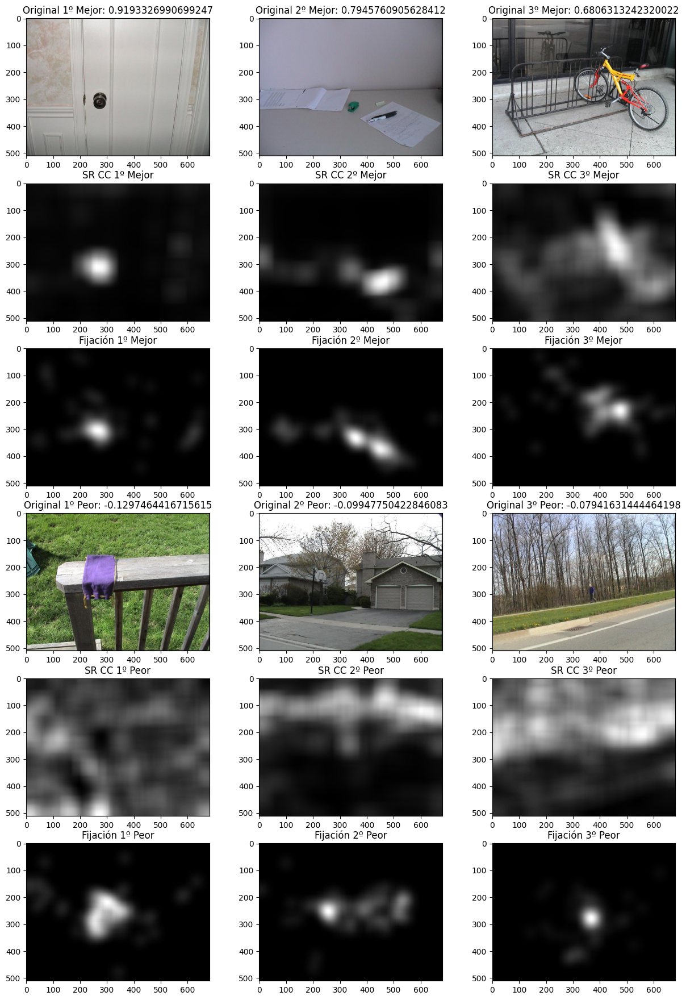

In [ ]:
# Organizar los resultados de CC en orden ascendente
SR_sorted_sms = sorted(SR_CC_scores)

# Seleccionar los tres mejores resultados de CC y ordenarlos de forma descendente
best3 = sorted(SR_sorted_sms[len(SR_CC_scores)-3:len(SR_CC_scores)])[::-1]

# Seleccionar los tres peores resultados de CC y ordenarlos de forma descendente
worst3 = SR_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SR_CC_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SR_sms[SR_CC_scores.index((best3)[i])], cmap='gray'), plt.title('SR CC {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_CC_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SR_CC_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SR_sms[SR_CC_scores.index((worst3)[i])], cmap='gray'), plt.title('SR CC {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SR_CC_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

#### **Residuo espectral CON color (SR+COLOR)**

##### **AUC judd**

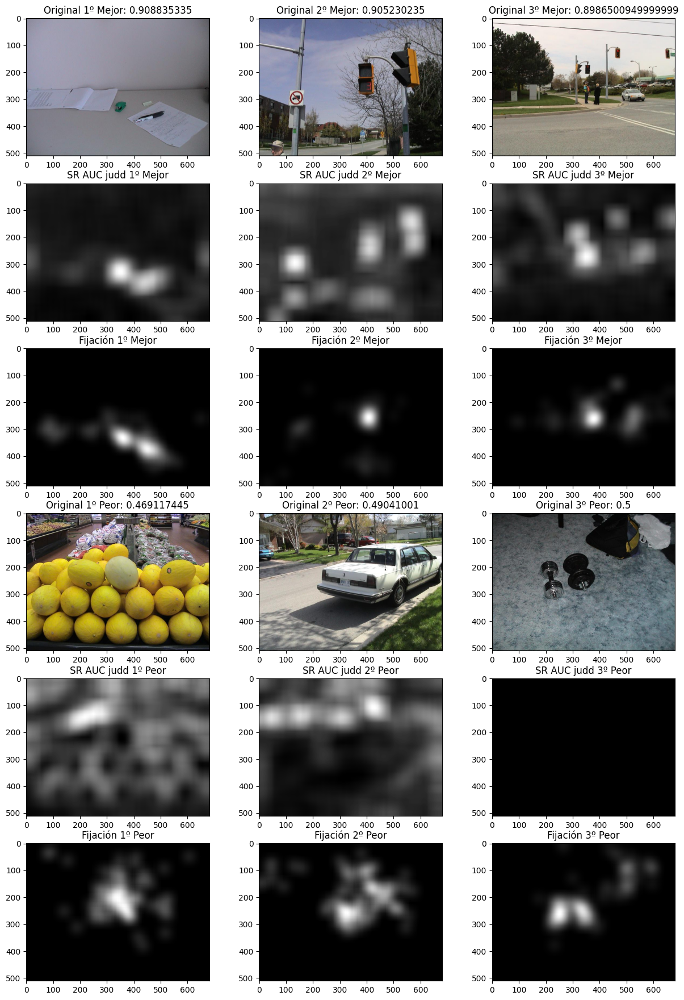

In [ ]:
# Organizar los resultados de AUC en orden ascendente
SRColor_sorted_sms = sorted(SRColor_AUCjudd_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(SRColor_sorted_sms[len(SRColor_AUCjudd_scores)-3:len(SRColor_AUCjudd_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = SRColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SRColor_AUCjudd_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SRColor_sms[SRColor_AUCjudd_scores.index((best3)[i])], cmap='gray'), plt.title('SR AUC judd {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_AUCjudd_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SRColor_AUCjudd_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SRColor_sms[SRColor_AUCjudd_scores.index((worst3)[i])], cmap='gray'), plt.title('SR AUC judd {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_AUCjudd_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **AUC shuffled**

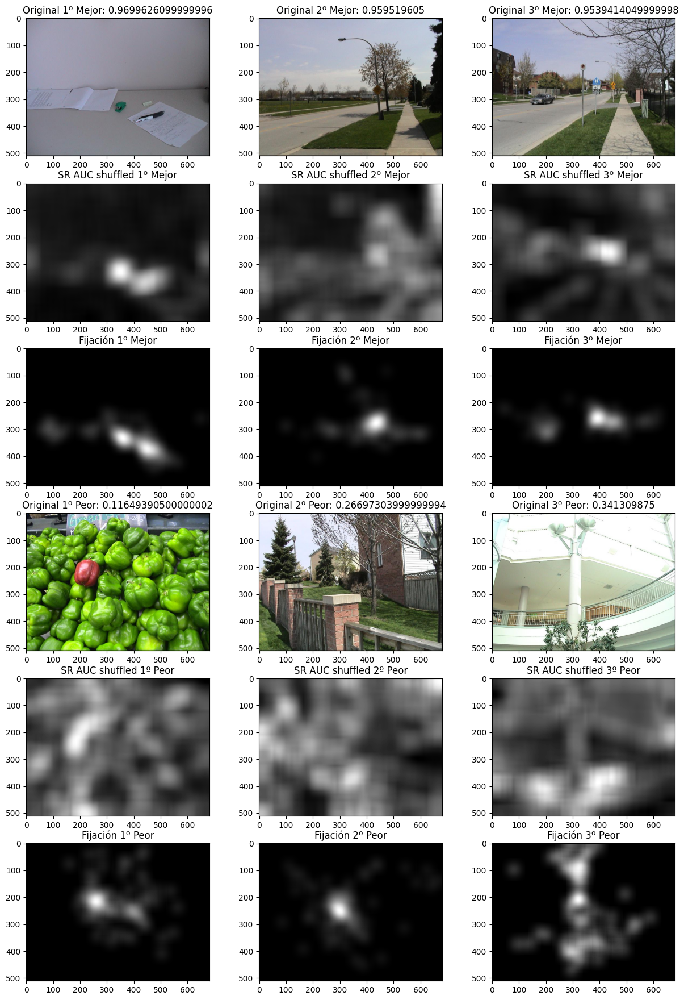

In [ ]:
# Organizar los resultados de AUC en orden ascendente
SRColor_sorted_sms = sorted(SRColor_AUCshuff_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(SRColor_sorted_sms[len(SRColor_AUCshuff_scores)-3:len(SRColor_AUCshuff_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = SRColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SRColor_AUCshuff_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SRColor_sms[SRColor_AUCshuff_scores.index((best3)[i])], cmap='gray'), plt.title('SR AUC shuffled {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_AUCshuff_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SRColor_AUCshuff_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SRColor_sms[SRColor_AUCshuff_scores.index((worst3)[i])], cmap='gray'), plt.title('SR AUC shuffled {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_AUCshuff_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **NSS**

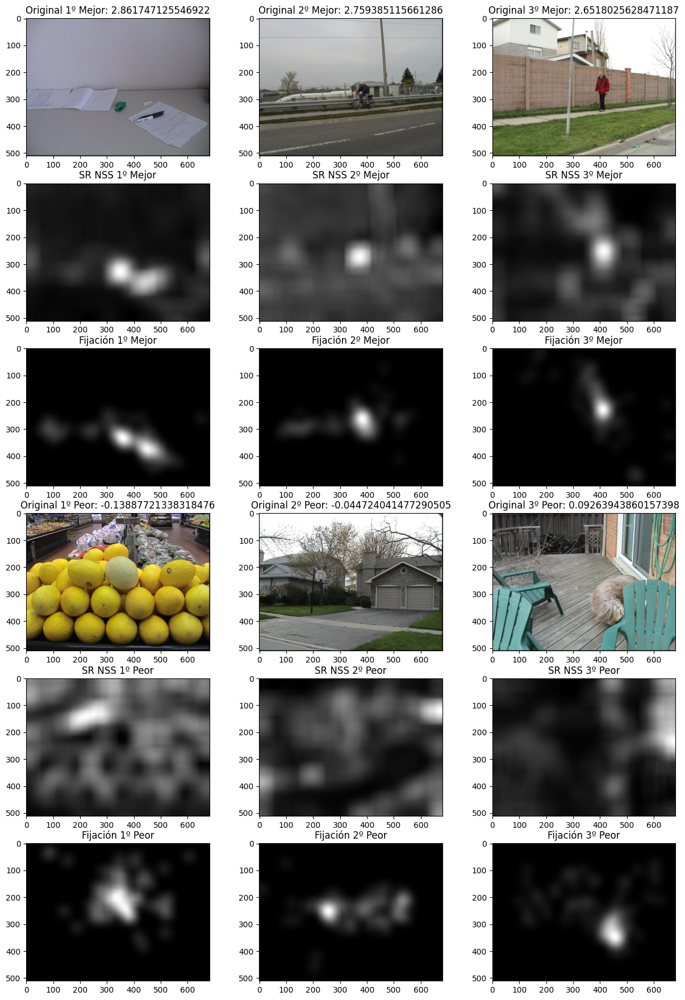

In [ ]:
# Organizar los resultados de NSS en orden ascendente
SRColor_sorted_sms = sorted(SRColor_NSS_scores)

# Seleccionar los tres mejores resultados de NSS y ordenarlos de forma descendente
best3 = sorted(SRColor_sorted_sms[len(SRColor_NSS_scores)-3:len(SRColor_NSS_scores)])[::-1]

# Seleccionar los tres peores resultados de NSS y ordenarlos de forma descendente
worst3 = SRColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SRColor_NSS_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SRColor_sms[SRColor_NSS_scores.index((best3)[i])], cmap='gray'), plt.title('SR NSS {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_NSS_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SRColor_NSS_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SRColor_sms[SRColor_NSS_scores.index((worst3)[i])], cmap='gray'), plt.title('SR NSS {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_NSS_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **CC**

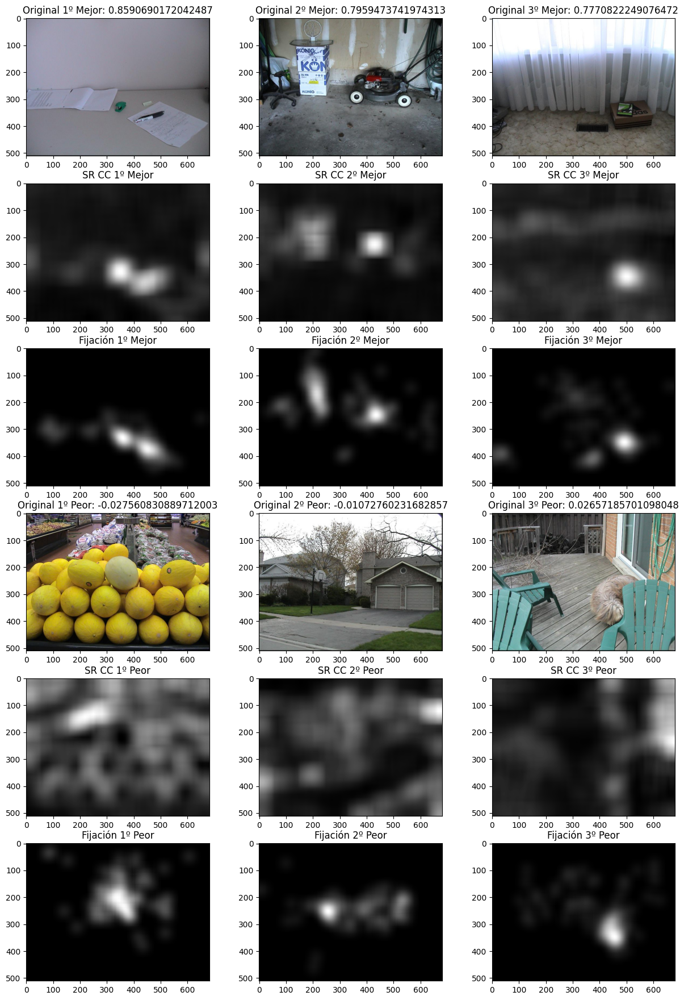

In [ ]:
# Organizar los resultados de CC en orden ascendente
SRColor_sorted_sms = sorted(SRColor_CC_scores)

# Seleccionar los tres mejores resultados de CC y ordenarlos de forma descendente
best3 = sorted(SRColor_sorted_sms[len(SRColor_CC_scores)-3:len(SRColor_CC_scores)])[::-1]

# Seleccionar los tres peores resultados de CC y ordenarlos de forma descendente
worst3 = SRColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[SRColor_CC_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(SRColor_sms[SRColor_CC_scores.index((best3)[i])], cmap='gray'), plt.title('SR CC {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_CC_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[SRColor_CC_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(SRColor_sms[SRColor_CC_scores.index((worst3)[i])], cmap='gray'), plt.title('SR CC {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,SRColor_CC_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

#### **Fase global SIN color (PFT)**

##### **AUC judd**

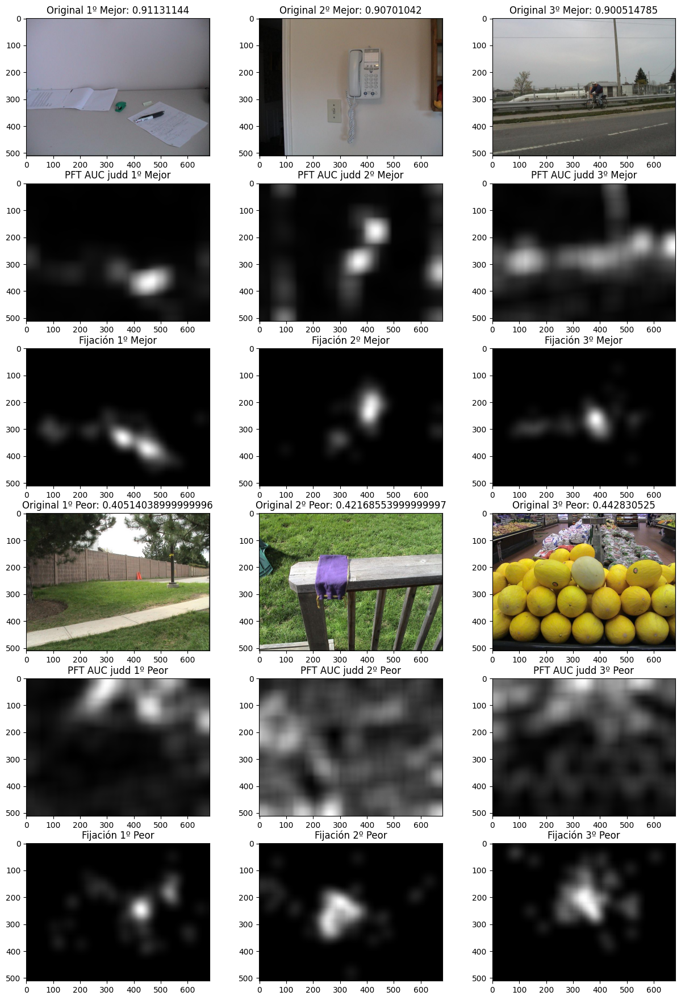

In [ ]:
# Organizar los resultados de AUC en orden ascendente
PFT_sorted_sms = sorted(PFT_AUCjudd_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(PFT_sorted_sms[len(PFT_AUCjudd_scores)-3:len(PFT_AUCjudd_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = PFT_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFT_AUCjudd_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFT_sms[PFT_AUCjudd_scores.index((best3)[i])], cmap='gray'), plt.title('PFT AUC judd {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_AUCjudd_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFT_AUCjudd_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFT_sms[PFT_AUCjudd_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT AUC judd {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_AUCjudd_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **AUC shuffled**

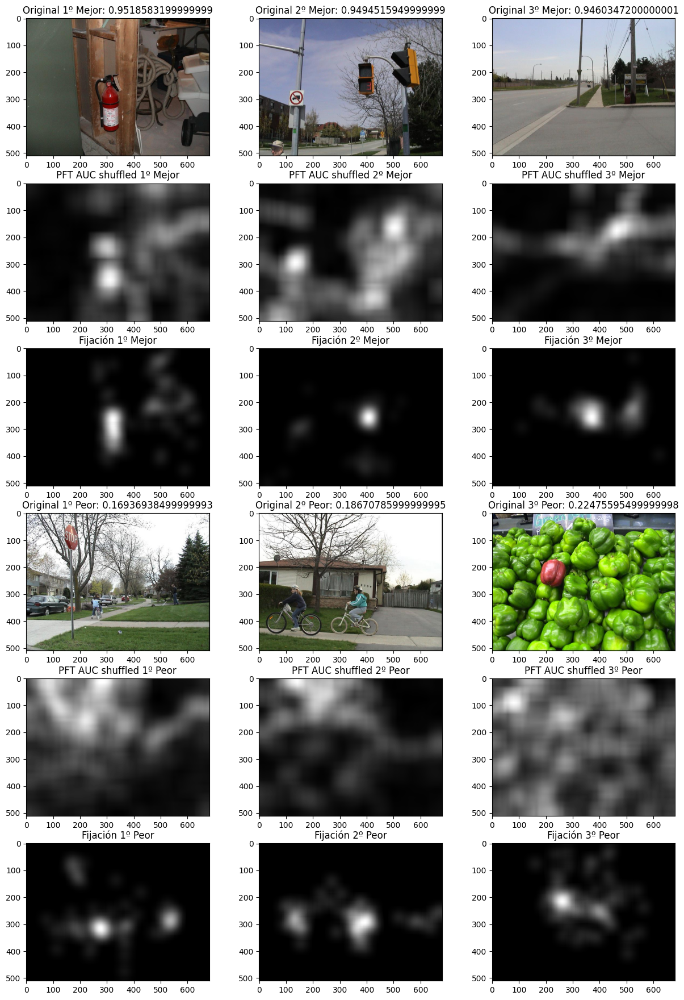

In [ ]:
# Organizar los resultados de AUC en orden ascendente
PFT_sorted_sms = sorted(PFT_AUCshuff_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(PFT_sorted_sms[len(PFT_AUCshuff_scores)-3:len(PFT_AUCshuff_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = PFT_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFT_AUCshuff_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFT_sms[PFT_AUCshuff_scores.index((best3)[i])], cmap='gray'), plt.title('PFT AUC shuffled {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_AUCshuff_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFT_AUCshuff_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFT_sms[PFT_AUCshuff_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT AUC shuffled {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_AUCshuff_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **NSS**

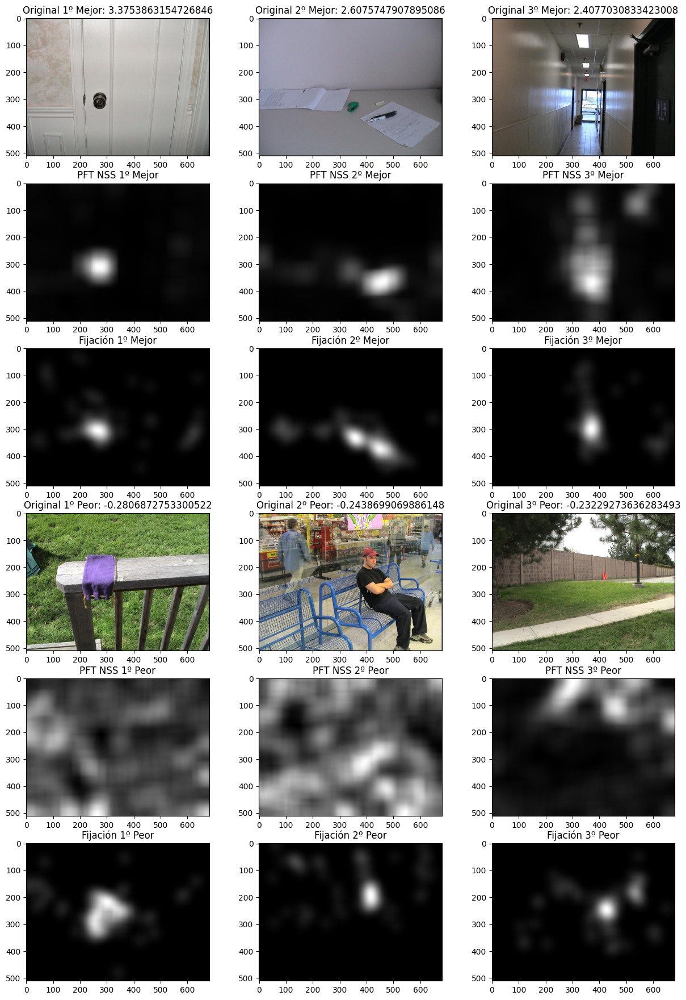

In [ ]:
# Organizar los resultados de NSS en orden ascendente
PFT_sorted_sms = sorted(PFT_NSS_scores)

# Seleccionar los tres mejores resultados de NSS y ordenarlos de forma descendente
best3 = sorted(PFT_sorted_sms[len(PFT_NSS_scores)-3:len(PFT_NSS_scores)])[::-1]

# Seleccionar los tres peores resultados de NSS
worst3 = PFT_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFT_NSS_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFT_sms[PFT_NSS_scores.index((best3)[i])], cmap='gray'), plt.title('PFT NSS {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_NSS_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFT_NSS_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFT_sms[PFT_NSS_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT NSS {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_NSS_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **CC**

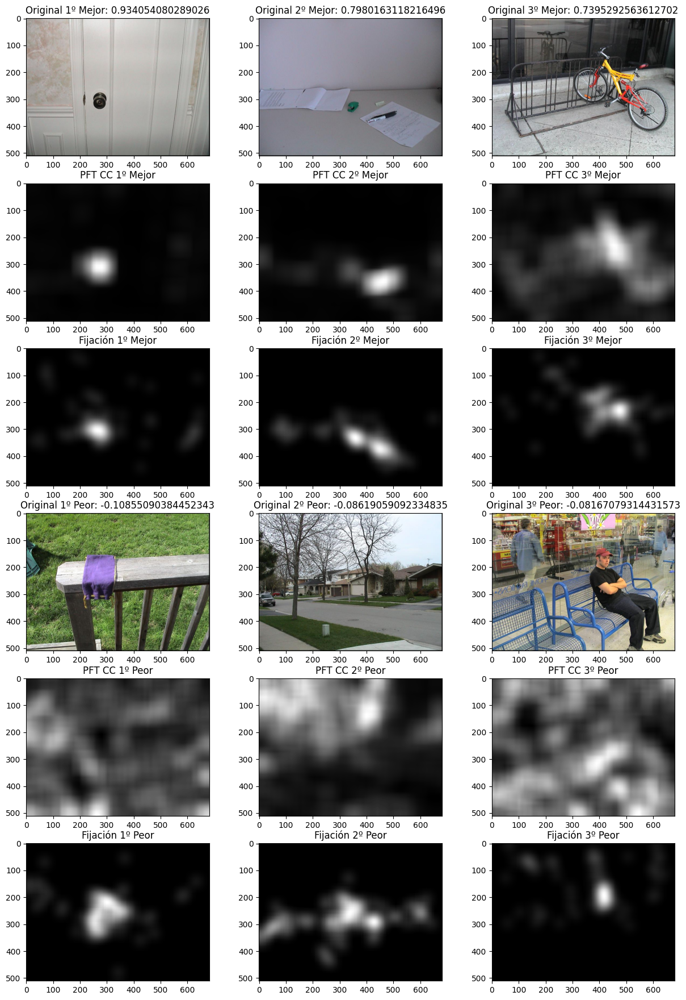

In [ ]:
# Organizar los resultados de CC en orden ascendente
PFT_sorted_sms = sorted(PFT_CC_scores)

# Seleccionar los tres mejores resultados de CC y ordenarlos de forma descendente
best3 = sorted(PFT_sorted_sms[len(PFT_CC_scores)-3:len(PFT_CC_scores)])[::-1]

# Seleccionar los tres peores resultados de CC
worst3 = PFT_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFT_CC_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFT_sms[PFT_CC_scores.index((best3)[i])], cmap='gray'), plt.title('PFT CC {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_CC_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFT_CC_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFT_sms[PFT_CC_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT CC {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFT_CC_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

#### **Fase global CON color (PFT+COLOR)**

##### **AUC judd**

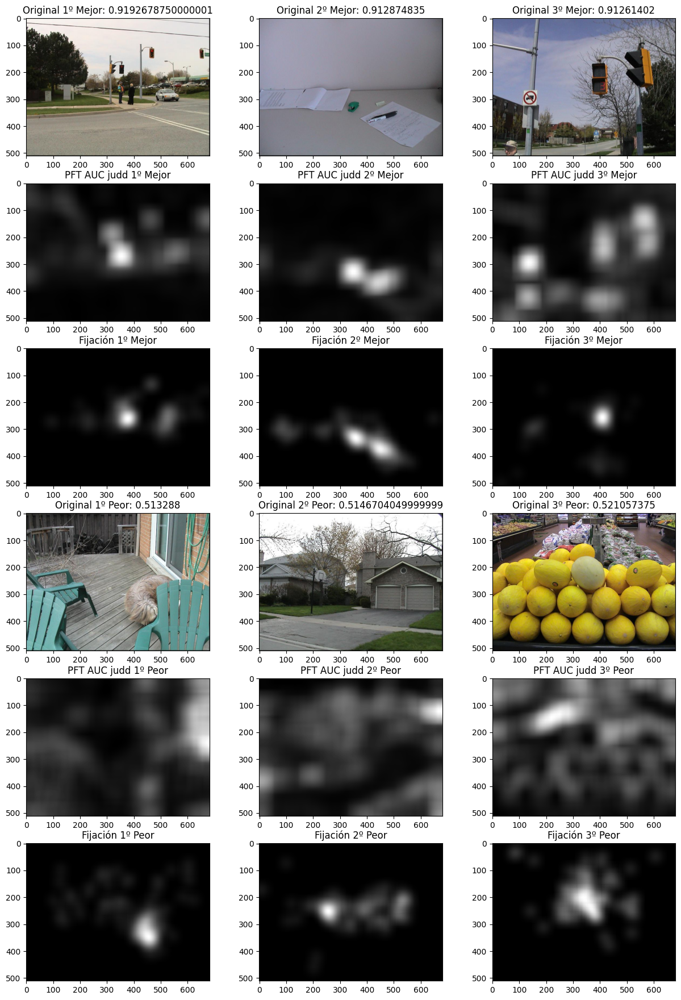

In [ ]:
# Organizar los resultados de AUC en orden ascendente
PFTColor_sorted_sms = sorted(PFTColor_AUCjudd_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(PFTColor_sorted_sms[len(PFTColor_AUCjudd_scores)-3:len(PFTColor_AUCjudd_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = PFTColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFTColor_AUCjudd_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFTColor_sms[PFTColor_AUCjudd_scores.index((best3)[i])], cmap='gray'), plt.title('PFT AUC judd {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_AUCjudd_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFTColor_AUCjudd_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFTColor_sms[PFTColor_AUCjudd_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT AUC judd {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_AUCjudd_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **AUC shuffled**

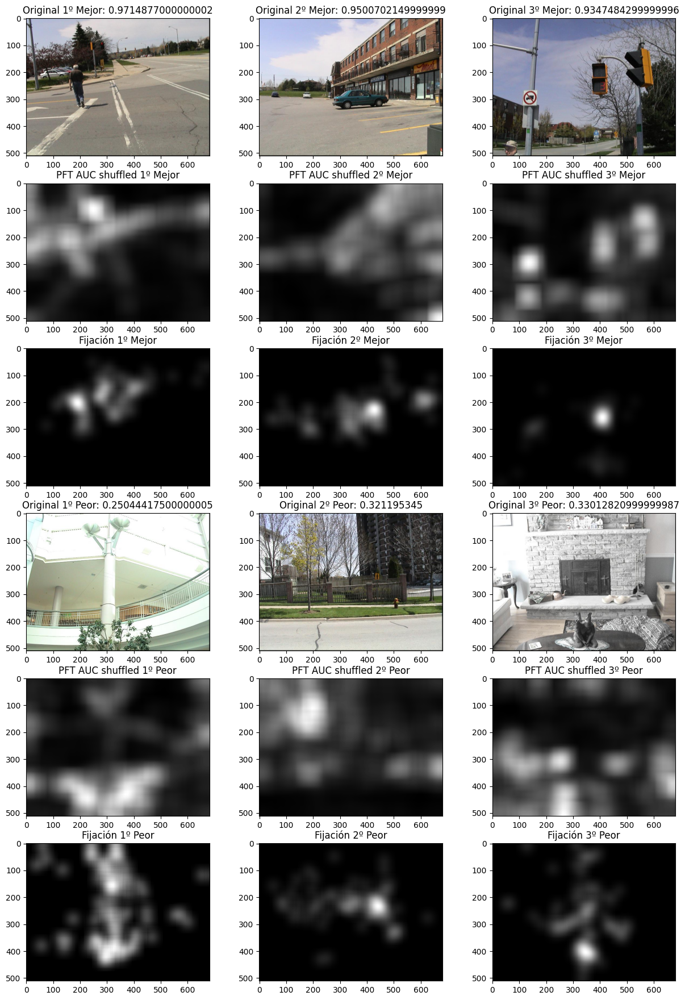

In [ ]:
# Organizar los resultados de AUC en orden ascendente
PFTColor_sorted_sms = sorted(PFTColor_AUCshuff_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(PFTColor_sorted_sms[len(PFTColor_AUCshuff_scores)-3:len(PFTColor_AUCshuff_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = PFTColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFTColor_AUCshuff_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFTColor_sms[PFTColor_AUCshuff_scores.index((best3)[i])], cmap='gray'), plt.title('PFT AUC shuffled {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_AUCshuff_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFTColor_AUCshuff_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFTColor_sms[PFTColor_AUCshuff_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT AUC shuffled {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_AUCshuff_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **NSS**

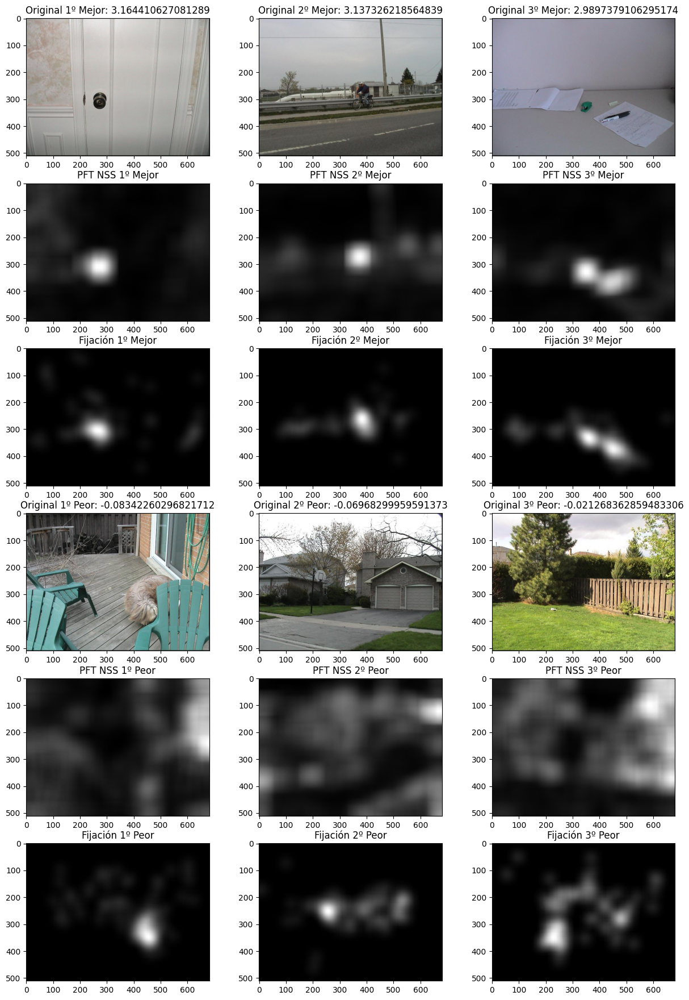

In [ ]:
# Organizar los resultados de NSS en orden ascendente
PFTColor_sorted_sms = sorted(PFTColor_NSS_scores)

# Seleccionar los tres mejores resultados de NSS y ordenarlos de forma descendente
best3 = sorted(PFTColor_sorted_sms[len(PFTColor_NSS_scores)-3:len(PFTColor_NSS_scores)])[::-1]

# Seleccionar los tres peores resultados de NSS
worst3 = PFTColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFTColor_NSS_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFTColor_sms[PFTColor_NSS_scores.index((best3)[i])], cmap='gray'), plt.title('PFT NSS {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_NSS_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFTColor_NSS_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFTColor_sms[PFTColor_NSS_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT NSS {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_NSS_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **CC**

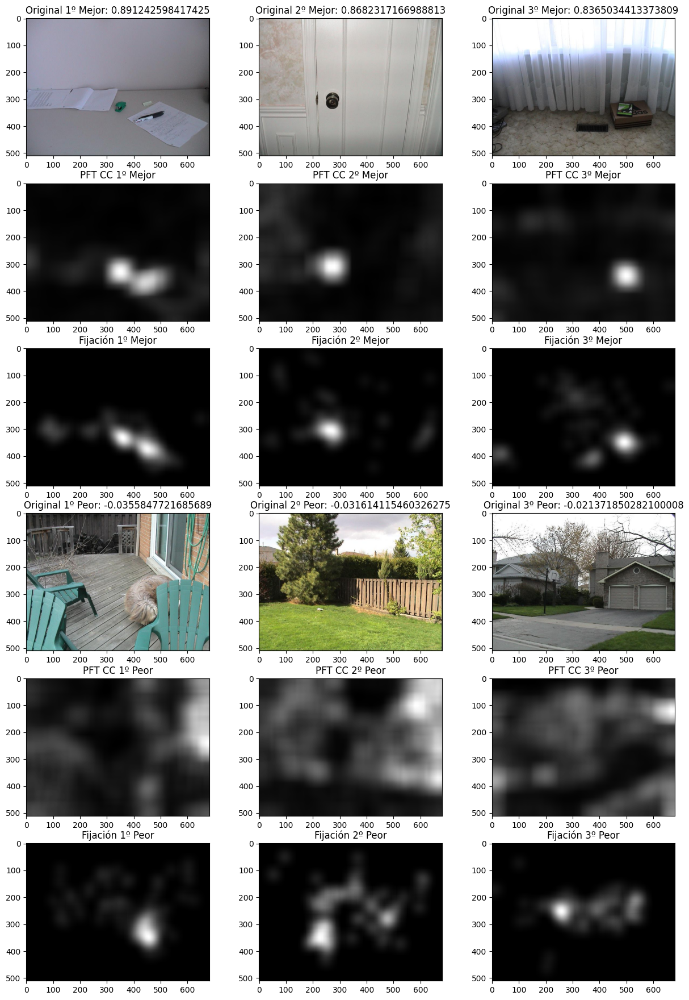

In [ ]:
# Organizar los resultados de CC en orden ascendente
PFTColor_sorted_sms = sorted(PFTColor_CC_scores)

# Seleccionar los tres mejores resultados de CC y ordenarlos de forma descendente
best3 = sorted(PFTColor_sorted_sms[len(PFTColor_CC_scores)-3:len(PFTColor_CC_scores)])[::-1]

# Seleccionar los tres peores resultados de CC
worst3 = PFTColor_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[PFTColor_CC_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(PFTColor_sms[PFTColor_CC_scores.index((best3)[i])], cmap='gray'), plt.title('PFT CC {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_CC_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[PFTColor_CC_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(PFTColor_sms[PFTColor_CC_scores.index((worst3)[i])], cmap='gray'), plt.title('PFT CC {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,PFTColor_CC_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

#### **Itti et al**

##### **AUC judd**

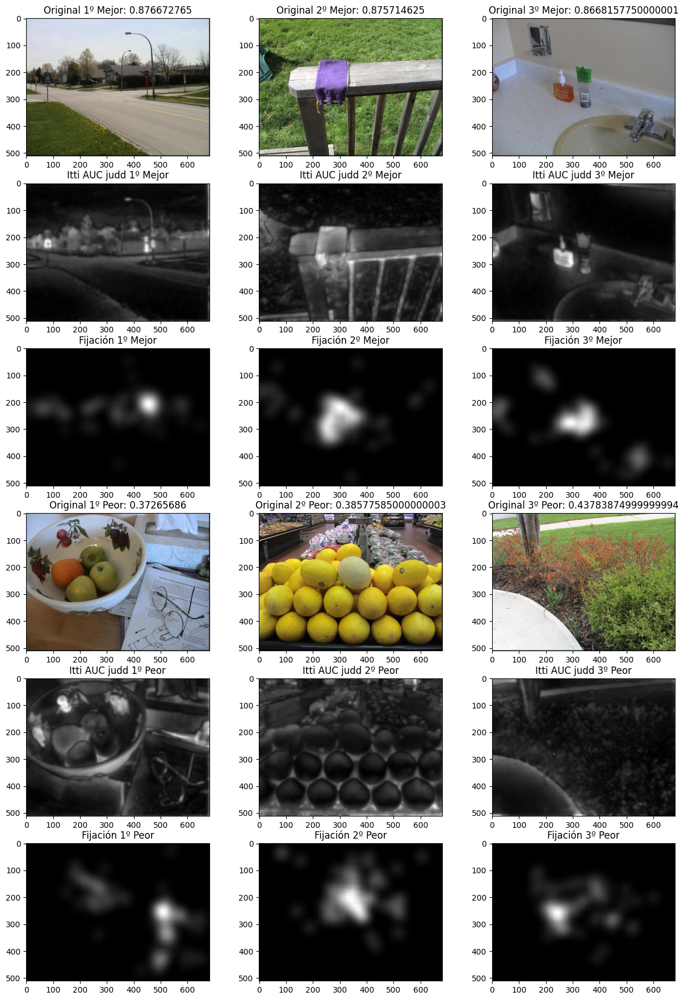

In [ ]:
# Organizar los resultados de AUC en orden ascendente
Itti_sorted_sms = sorted(Itti_AUCjudd_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(Itti_sorted_sms[len(Itti_AUCjudd_scores)-3:len(Itti_AUCjudd_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = Itti_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[Itti_AUCjudd_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(Itti_sms[Itti_AUCjudd_scores.index((best3)[i])], cmap='gray'), plt.title('Itti AUC judd {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_AUCjudd_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[Itti_AUCjudd_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(Itti_sms[Itti_AUCjudd_scores.index((worst3)[i])], cmap='gray'), plt.title('Itti AUC judd {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_AUCjudd_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **AUC shuffled**

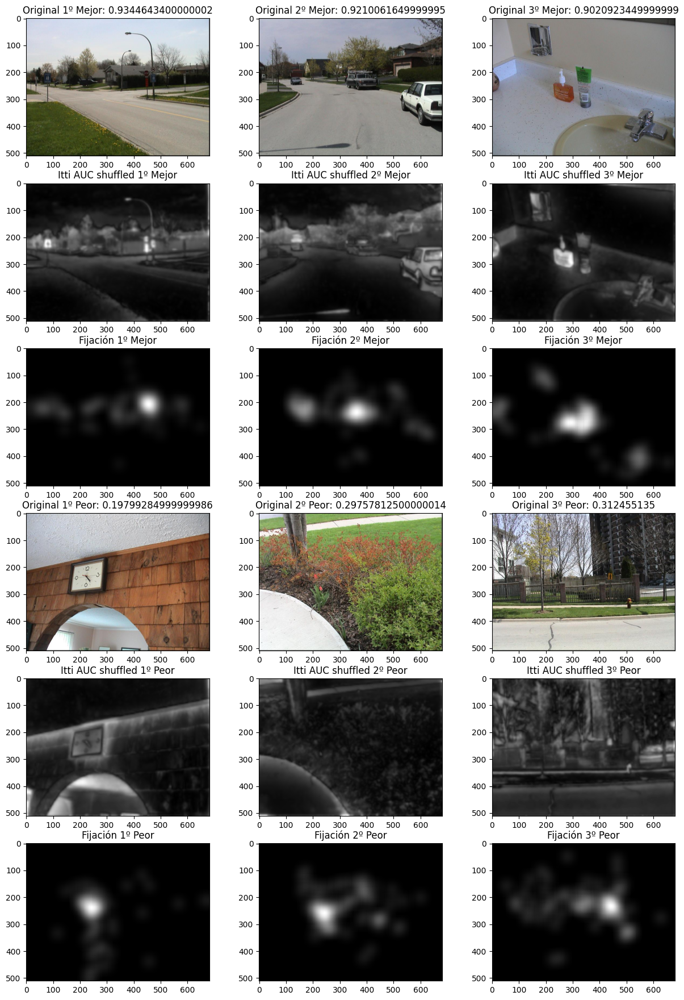

In [ ]:
# Organizar los resultados de AUC en orden ascendente
Itti_sorted_sms = sorted(Itti_AUCshuff_scores)

# Seleccionar los tres mejores resultados de AUC y ordenarlos de forma descendente
best3 = sorted(Itti_sorted_sms[len(Itti_AUCshuff_scores)-3:len(Itti_AUCshuff_scores)])[::-1]

# Seleccionar los tres peores resultados de AUC
worst3 = Itti_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[Itti_AUCshuff_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(Itti_sms[Itti_AUCshuff_scores.index((best3)[i])], cmap='gray'), plt.title('Itti AUC shuffled {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_AUCshuff_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[Itti_AUCshuff_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(Itti_sms[Itti_AUCshuff_scores.index((worst3)[i])], cmap='gray'), plt.title('Itti AUC shuffled {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_AUCshuff_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **NSS**

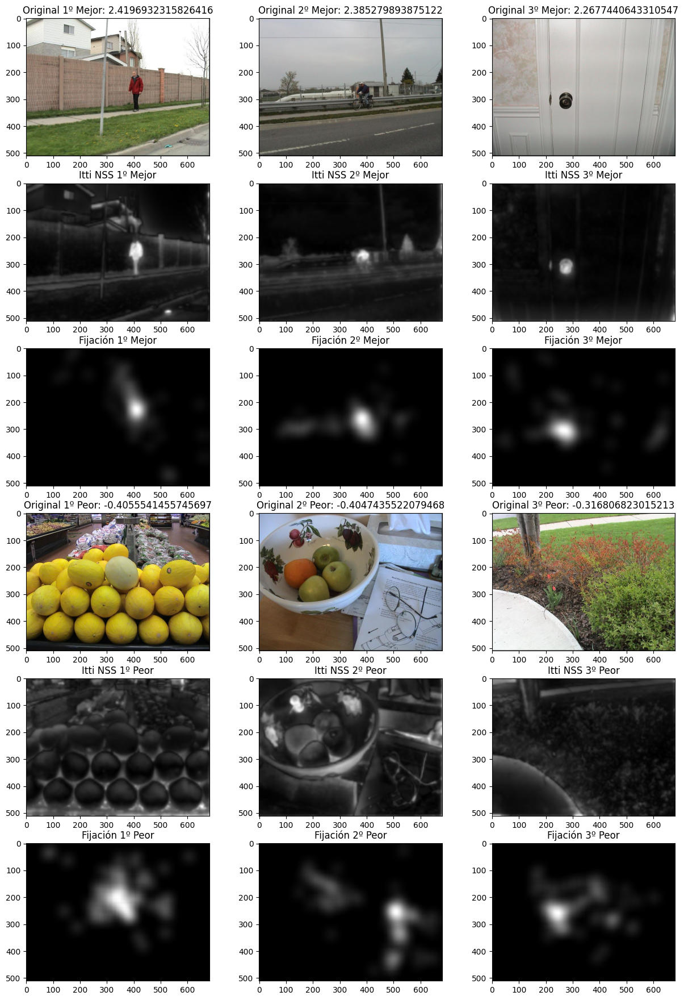

In [ ]:
# Organizar los resultados de NSS en orden ascendente
Itti_sorted_sms = sorted(Itti_NSS_scores)

# Seleccionar los tres mejores resultados de NSS y ordenarlos de forma descendente
best3 = sorted(Itti_sorted_sms[len(Itti_NSS_scores)-3:len(Itti_NSS_scores)])[::-1]

# Seleccionar los tres peores resultados de NSS
worst3 = Itti_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[Itti_NSS_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(Itti_sms[Itti_NSS_scores.index((best3)[i])], cmap='gray'), plt.title('Itti NSS {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_NSS_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[Itti_NSS_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(Itti_sms[Itti_NSS_scores.index((worst3)[i])], cmap='gray'), plt.title('Itti NSS {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_NSS_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

##### **CC**

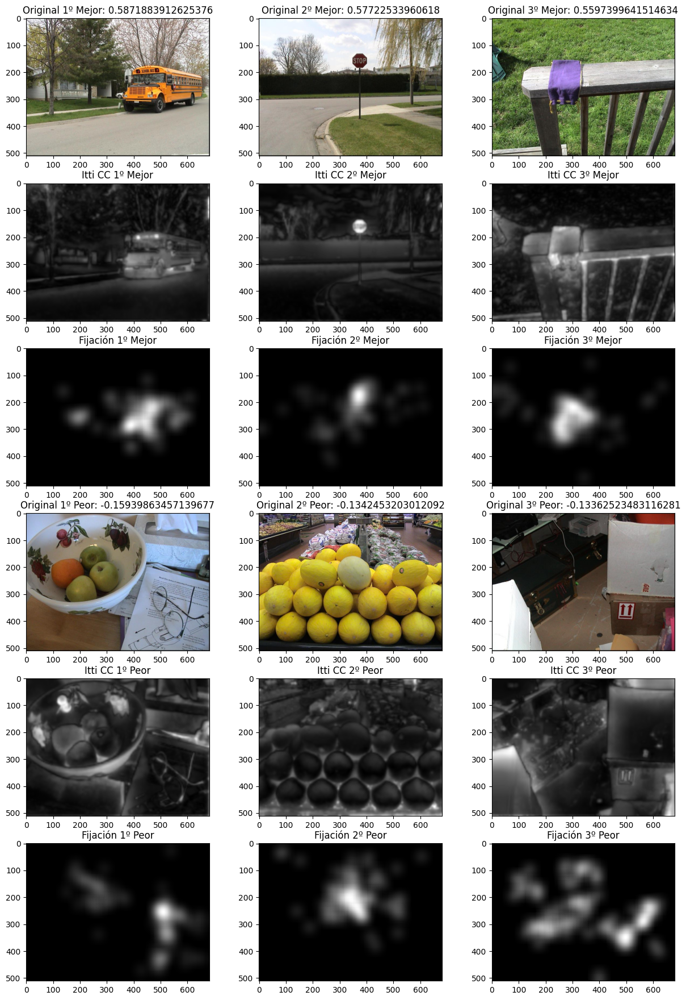

In [ ]:
# Organizar los resultados de CC en orden ascendente
Itti_sorted_sms = sorted(Itti_CC_scores)

# Seleccionar los tres mejores resultados de CC y ordenarlos de forma descendente
best3 = sorted(Itti_sorted_sms[len(Itti_CC_scores)-3:len(Itti_CC_scores)])[::-1]

# Seleccionar los tres peores resultados de CC
worst3 = Itti_sorted_sms[0:3]

# Visualización de los resultados
plt.figure(figsize=[15,22])
for i in range(3):
    # 3 MEJORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)), plt.imshow(cv2.cvtColor(images[Itti_CC_scores.index((best3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Mejor: {}'.format(i+1, (best3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+3), plt.imshow(Itti_sms[Itti_CC_scores.index((best3)[i])], cmap='gray'), plt.title('Itti CC {}º Mejor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_CC_scores.index((best3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+6), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Mejor'.format(i+1))

    # 3 PEORES casos
    # Imagen original
    plt.subplot(6,3,(i+1)+9), plt.imshow(cv2.cvtColor(images[Itti_CC_scores.index((worst3)[i])], cv2.COLOR_BGR2RGB)), plt.title('Original {}º Peor: {}'.format(i+1, (worst3)[i]))
    # Mapa de saliencia obtenido
    plt.subplot(6,3,(i+1)+12), plt.imshow(Itti_sms[Itti_CC_scores.index((worst3)[i])], cmap='gray'), plt.title('Itti CC {}º Peor'.format(i+1))
    # Mapa de saliencia del humano
    fix = fixation_maps['white'][0,Itti_CC_scores.index((worst3)[i])]
    map_den_fix = np.floor(cv2.normalize(cv2.GaussianBlur(np.float32(fix),(85,85),20,20), None, 0, 255, cv2.NORM_MINMAX)).astype(np.uint8)
    plt.subplot(6,3,(i+1)+15), plt.imshow(map_den_fix, cmap='gray'), plt.title('Fijación {}º Peor'.format(i+1))

plt.show()

#### **Análisis**
Observando generalmente los resultados para cada modelo y métrica podemos comprobar que en la mayoría de los casos, los 3 mejores/peores suelen coincidir entre modelos y métricas, esto sugiere que las anomalías de dichas imágenes son fáciles/difíciles detectar para nuestros algoritmos.